# TCGA RNA-seq Data Analysis Report

## Introduction

In this report, we describe the data pre-processing steps used to compare the Metabopathia approach with Hipathia. First, a Principal Component Analysis (PCA) and quality control analysis were performed on the RNA-seq data. RNA-seq data were obtained from 12 different cancer types from The Cancer Genome Atlas (TCGA) data portal (https://tcga-data.nci.nih.gov/tcga/). For these cancer types, RNA-seq counts were available for both healthy control and cancer samples:
- Bladder Urothelial Carcinoma (BLCA) [https://doi.org/10.1038/nature12965, https://doi.org/10.1016/j.cell.2017.09.007],
- Breast invasive carcinoma (BRCA) [https://doi.org/10.1038/nature11412, https://doi.org/10.1016/j.cell.2015.09.033],
- Colorectal Adenocarcinoma (COAD) [https://doi.org/10.1038/nature11252],
- Head and Neck squamous cell carcinoma (HNSC) [https://doi.org/10.1038/nature14129],
- (Kidney) Clear Cell Renal Cell Carcinoma (KIRC) [https://doi.org/10.1038/nature12222], 
- (Kidney) Papillary Renal Cell Carcinomaa (KIRP) [10.1056/NEJMoa1505917],
- Liver hepatocellular carcinoma (LIHC) [https://doi.org/10.1016/j.cell.2017.05.046],
- Lung adenocarcinoma (LUAD) [https://doi.org/10.1038/nature13385, https://doi.org/10.1038/ng.3564],
- Lung squamous cell carcinoma (LUSC) [https://doi.org/10.1038/nature11404, https://doi.org/10.1038/ng.3564],
- Prostate adenocarcinoma (PRAD) [https://doi.org/10.1016/j.cell.2015.10.025],
- Thyroid carcinoma (THCA) [https://doi.org/10.1016/j.cell.2014.09.050],
- Uterine Corpus Endometrioid Carcinoma (UCEC) [https://doi.org/10.1038/nature12113]

## Loading Libraries and sourcing needed files 

In [2]:
# Source utils.R file: where functions are pre-definded:
source("utils.R")

# Define packages
cran_packages <- c("ggplot2", "dplyr", "tibble", "data.table", "FactoMineR", "factoextra", "mixOmics", "tidyverse")# Here I have to pay att with libraries conflicts
bioc_packages <- c("SummarizedExperiment", "SEtools", "edgeR") #EDASeq

# Call the function to install or load packages
check_and_install(cran_packages, bioc_packages, condaEnv = T)

## Data Acquisition and Preparation

### Define Cancer Types and Paths

In [3]:
#This cancers was mentioned as used cancers to remove batch effect but are not the same
cancer_list <- c("BLCA","BRCA","COAD","HNSC","KIRC","KIRP","LIHC","LUAD","LUSC","PRAD","THCA","UCEC")
cancer_list_names <- c("Bladder Urothelial Carcinoma",
                       "Breast invasive carcinoma",
                       "Colorectal Adenocarcinoma",
                       "Head and Neck squamous cell carcinoma",
                       "Kidney Clear Cell Renal Cell Carcinoma",
                       "Kidney Papillary Renal Cell Carcinomaa",
                       "Liver hepatocellular carcinoma",
                       "Lung adenocarcinoma",
                       "Lung squamous cell carcinoma",
                       "Prostate adenocarcinoma",
                       "Thyroid carcinoma",
                       "Uterine Corpus Endometrioid Carcinoma")

In [4]:
cancer_list_id <- paste("TCGA", cancer_list, sep = "-")
names(cancer_list_names) <- cancer_list_id

As mentioned earlier, this study focuses on RNA-seq data from 12 cancer types. The data were previously downloaded from The Cancer Genome Atlas (TCGA) using a series of shell scripts to automate the process and handle the large dataset efficiently.

### Data Download Process

To facilitate the download, we used a shell script (get_data_in_parallel.sh) that retrieves data for each cancer type in parallel. This was executed using the Slurm workload manager with the following command (retrieved on June 27, 2024):

```bash
sbatch --job-name=getData --mem=200000 --error='.err_parallel.job' --output='.out_parallel.job' get_data_in_parallel.sh {BLCA,BRCA,COAD,HNSC,KIRC,KIRP,LIHC,LUAD,LUSC,PRAD,THCA,UCEC}
```

```sbatch``` command to submit the job to the Slurm scheduler.
```--job-name``` Option specifies the name of the job as getData for example.
```--mem=200000``` Allocates 200 GB of memory for the job, depends on available resources in the cluster!
```--error``` and ```--output```: To write error and output logs to specific files (.err_parallel.job and .out_parallel.job).

#### Script Details

- **`get_data_in_parallel.sh`**: This script initiates the download process in parallel for the specified cancer types. You can find the script at the following link: [get_data_in_parallel.sh](https://github.com/kinzaR/metabopathia/blob/main/data_examples/TCGA/get_data_in_parallel.sh).

> **Note**: This command may require adaptation depending on the resources available in your computing environment. Adjustments to this command will not affect the reproducibility of this report.


#### Shell Scripts Used

- **`get_data_in_parallel.sh`**: This script manages the parallel execution of the data retrieval for each cancer type by calling the next script for each specified type.  
  [View on GitHub](https://github.com/kinzaR/metabopathia/blob/main/data_examples/TCGA/get_data_in_parallel.sh)

- **`get_data_per_cancer.sh`**: This script is called by the parallel script to handle the data download for a single cancer type.  
  [View on GitHub](https://github.com/kinzaR/metabopathia/blob/main/data_examples/TCGA/get_data_per_cancer.sh)

- **`gdc_getData.R`**: An R script that interacts with the TCGA data portal to fetch the RNA-seq data.  
  [View on GitHub](https://github.com/kinzaR/metabopathia/blob/main/data_examples/TCGA/gdc_getData.R)


#### Data Storage

The downloaded data is organized in a folder named `processed_data`. Within this folder, there are subfolders for each cancer type containing the following:

- Temporary files generated during the download process.
- The key output file: `counts?<cancerID>.RData`, which contains the RNA-seq counts for each cancer type and will be used in subsequent analysis steps.

By organizing the download process in this manner, we ensure that the data acquisition is efficient, reproducible (data retrieved from TCGA portal on June 27, 2024), and easy to manage. This structure allows us to quickly access and process the data for downstream analysis.


In [5]:
my_dir <- "processed_data/"

In [6]:
data_list <- lapply(cancer_list_id, load_data, my_dir)
#names(data_list) <- cancer_list_id
names(data_list) <- lapply(data_list, function(d){colData(d)$project_id  %>% unique}) %>% unlist # to be more sure :S

In [7]:
countdata_list <- lapply(data_list, assay, i ='unstranded') %>% lapply(data.table::as.data.table,keep.rownames = T)
# rownames are strred in the first column called rn

In [8]:
metadata_list <- lapply(data_list, function(d){
    colData(d) %>% data.table::as.data.table() %>% dplyr::select(c(barcode, project_id, sample_type)) 
})

In [9]:
#all_metaType in the data
lapply(data_list, function(d){
    colData(d) %>% data.table::as.data.table() %>% dplyr::select(c('sample_type_id','sample_type','specimen_type','tissue_type')) %>% unique
}) %>%do.call(what = rbind, args = .) %>% unique

sample_type_id,sample_type,specimen_type,tissue_type
<chr>,<chr>,<chr>,<chr>
01,Primary Tumor,Solid Tissue,Tumor
11,Solid Tissue Normal,Solid Tissue,Normal
06,Metastatic,Unknown,Tumor
02,Recurrent Tumor,Solid Tissue,Tumor
05,Additional - New Primary,Unknown,Tumor
01,Primary Tumor,Unknown,Tumor


In [10]:
# Checking if the .rds files already exist before saving them:
check_and_save_RDSs(data=countdata_list, metadata=metadata_list,
                    my_dir=my_dir, version="v1", 
                    prefix_countdata_file= "unstranded_counts_data_list_", 
                    prefix_metadata_file ="counts_metadata_list_")

File already exists: processed_data//unstranded_counts_data_list_v1.rds

File already exists: processed_data//counts_metadata_list_v1.rds



In [11]:
get_object_size()

Object,Size
<chr>,<chr>
data_list,14877 Mb
countdata_list,1678 Mb
metadata_list,0.7 Mb
check_and_install,0.1 Mb


### Load previously saved Data (RDS files)

This step is for situations where the counts and metadata have already been saved as RDS files, allowing us to load the existing data and start from there, bypassing the initial steps.

In [12]:
version_of_data <- "v1"
countdata_list <- load_RDS_data(name="countdata_list",my_dir, version= version_of_data, prefix_file= "unstranded_counts_data_list_" )
metadata_list <- load_RDS_data(name="metadata_list",my_dir, version= version_of_data, prefix_file= "counts_metadata_list_" )

countdata_list is already loaded in the environment.

metadata_list is already loaded in the environment.



## Metadata Overview and Initial Data Exploration

### Examination of Participant and Sample Counts in Tumor and Normal Data

In [13]:
sapply(countdata_list, dim) %>% .[2,] %>% sum - 12 # 12 rownames column ;)

[1] 6981

This dataset contains a total of 6,981 samples (first column is for gene names) from 6,251 cases (The number of samples is higher than the number of cases because some patients have more than one sample).
Next, we will load the metadata, which contains information about each sample—barcode, project ID, and the type of tissue sample

In the folowing plot , we can check the number of samples and the number of participants/cases per cancer type:

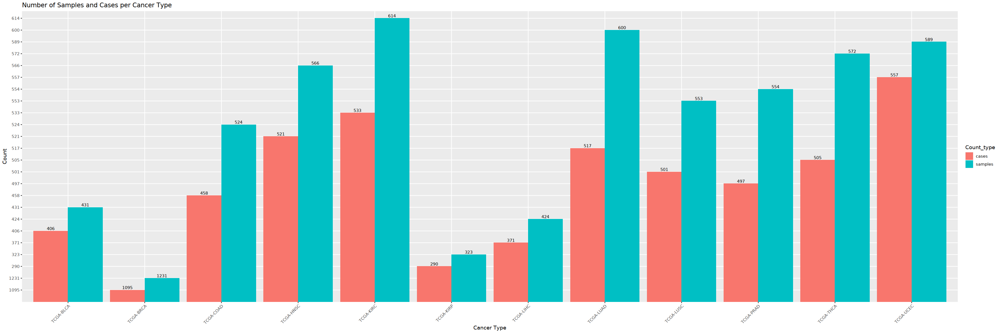

In [14]:
options(repr.plot.width = 30, repr.plot.height = 10)  
plot_cases_vs_samples(metadata_list)

In [15]:
# Here we will check the percentage of paired samples in normals and in tumor as well
metadata_info<-get_info_counts(metadata_list)


In [16]:
metadata_info

,perc_Paired_samples_in_Normals,perc_Paired_samples_in_Tumors,Tot_part_Tumors,Tot_Samples_Tumors,Tot_part_Normals,Tot_Samples_Normals,dup_participat_in_Normals,dup_participat_in_Tumors
,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>
TCGA-BLCA,100,4.679802....,406,412,19,19,0,6
TCGA-BRCA,100,10.31963....,1095,1118,113,113,0,23
TCGA-COAD,100,8.951965....,458,483,41,41,0,25
TCGA-HNSC,97.72727....,8.269230....,520,522,44,44,0,2
TCGA-KIRC,100,13.50844....,533,542,72,72,0,9
TCGA-KIRP,100,11.03448....,290,291,32,32,0,1
TCGA-LIHC,100,13.47708....,371,374,50,50,0,3
TCGA-LUAD,98.30508....,11.24031....,516,541,59,59,0,25
TCGA-LUSC,100,10.17964....,501,502,51,51,0,1


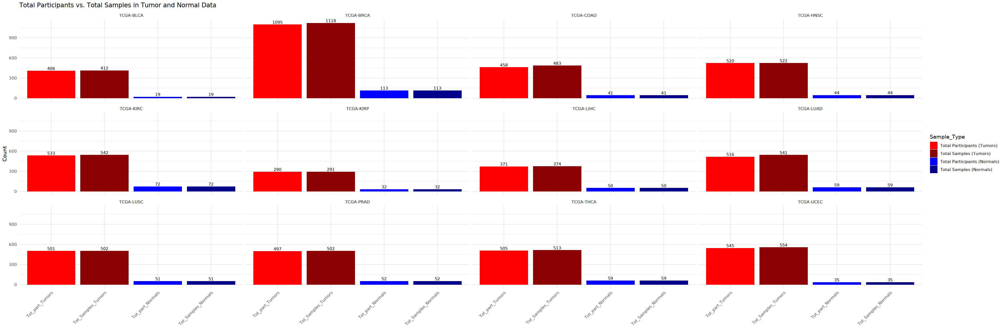

In [17]:
plot_case_vs_samples_per_tissueType(metadata_info)

### Paired data across cancer types

In [18]:
metadata_info %>% dplyr::select(perc_Paired_samples_in_Normals,perc_Paired_samples_in_Tumors)

,perc_Paired_samples_in_Normals,perc_Paired_samples_in_Tumors
,<named list>,<named list>
TCGA-BLCA,100,4.679802....
TCGA-BRCA,100,10.31963....
TCGA-COAD,100,8.951965....
TCGA-HNSC,97.72727....,8.269230....
TCGA-KIRC,100,13.50844....
TCGA-KIRP,100,11.03448....
TCGA-LIHC,100,13.47708....
TCGA-LUAD,98.30508....,11.24031....
TCGA-LUSC,100,10.17964....


This section presents a table showing the percentage of paired samples between **Normal** and **Tumor** tissues across various cancer types from the **TCGA** (The Cancer Genome Atlas) dataset.

- **perc_Paired_samples_in_Normals**: The percentage of normal samples that are paired with tumor samples.
- **perc_Paired_samples_in_Tumors**: The percentage of tumor samples that are paired with normal samples.

> **⚠️ Important Notice:**
> - Most cancer types have **100% of their normal samples paired** with corresponding tumor samples (e.g., TCGA-BLCA, TCGA-BRCA, TCGA-COAD).
> - The percentage of tumor samples paired with normal samples is generally lower, with values ranging from **4.22% to 13.51%**, depending on the cancer type.
> - **TCGA-UCEC** has a notably lower percentage of paired normal samples (**65.71%**), which is an outlier compared to the other cancer types.
> - The variability in tumor-normal pairing highlights that while most normal samples are paired, a much smaller proportion of tumor samples have corresponding normal pairs.



### Summary of Preservation Methods Across Sample Types and Cancer Types 

In [19]:
preservation_summary <- suppressMessages(summarize_preservation_methods(data_list))

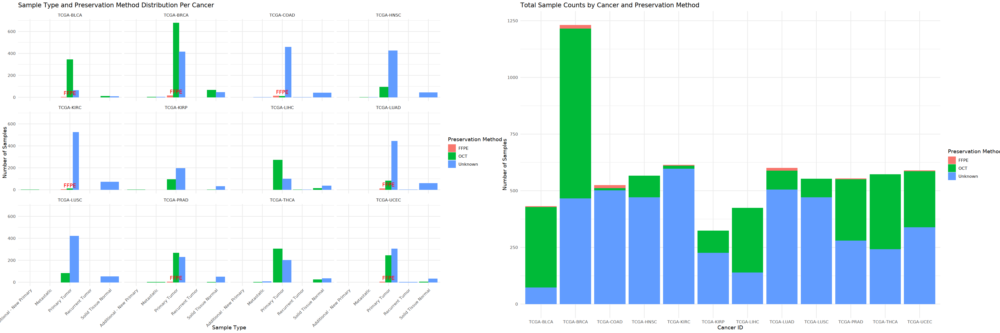

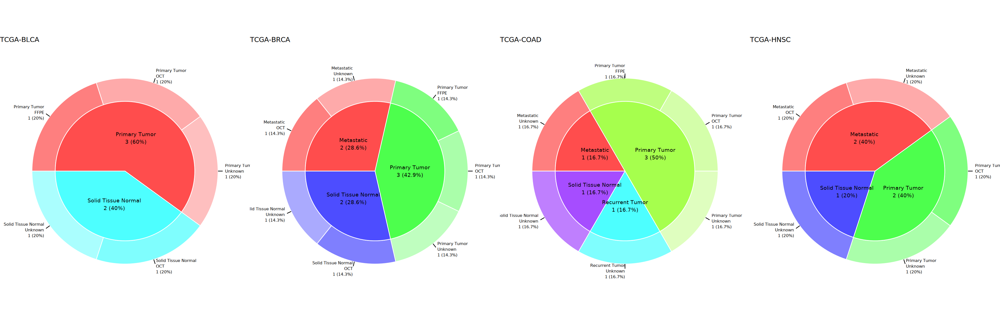

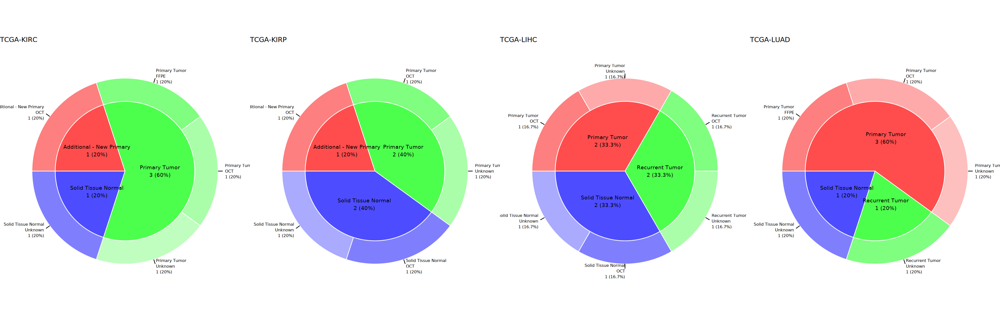

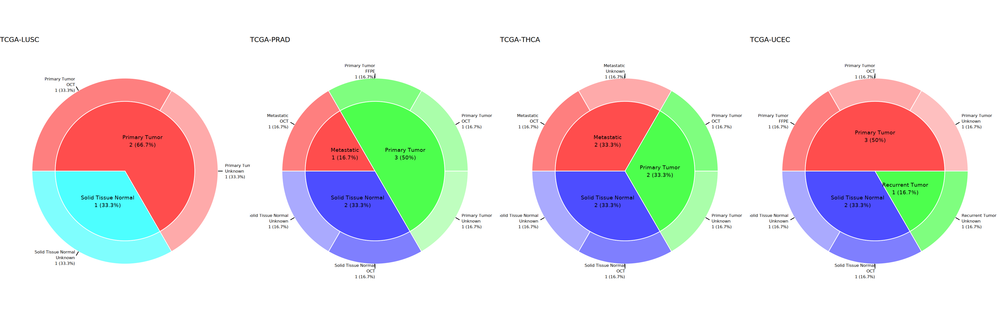

In [20]:
plots_preservation_methods(preservation_summary)
piPlots_preservation_methods(preservation_summary,0) # this need enhancment : code and colors need to be the same coherents
piPlots_preservation_methods(preservation_summary,4)
piPlots_preservation_methods(preservation_summary,8)

In [21]:
preservation_summary %>% filter(cancer_id=="TCGA-BLCA")

sample_type,preservation_method,n,cancer_id
<chr>,<chr>,<int>,<chr>
Primary Tumor,FFPE,3,TCGA-BLCA
Primary Tumor,OCT,345,TCGA-BLCA
Solid Tissue Normal,OCT,10,TCGA-BLCA
Primary Tumor,Unknown,64,TCGA-BLCA
Solid Tissue Normal,Unknown,9,TCGA-BLCA


> These graphs need enhancements in visualization for better interpretation. The aim here is to show that the FFPE preservation method was used exclusively for Tumor samples and not for Normal samples in certain cancers.
>
> **e.g. BLCA cancer :** 
> 
> - **3 Primary Tumor samples** have used the **FFPE preservation method**. This method was used exclusively for **Tumor samples** and not for **Normal samples** in some cancers.
> - in BLCA There are **73 samples** with an **Unknown preservation method**, of which **64 are Primary Tumor samples** and **9 are Solid Tissue Normal samples**.


In [22]:
get_object_size()

Object,Size
<chr>,<chr>
data_list,14877 Mb
countdata_list,1678 Mb
get_info_counts,1 Mb
metadata_list,0.7 Mb
change_label,0.1 Mb
check_and_install,0.1 Mb
get_object_size,0.1 Mb
plot_case_vs_samples_per_tissueType,0.1 Mb
plot_cases_vs_samples,0.1 Mb


In [23]:
# No need for data_list, will be removed
rm(data_list)
get_object_size()

Object,Size
<chr>,<chr>
countdata_list,1678 Mb
get_info_counts,1 Mb
metadata_list,0.7 Mb
change_label,0.1 Mb
check_and_install,0.1 Mb
get_object_size,0.1 Mb
plot_case_vs_samples_per_tissueType,0.1 Mb
plot_cases_vs_samples,0.1 Mb
plot_Preservation_Method_Distribution,0.1 Mb


## Quality Control and Normalization

### Filter Lowly Expressed Genes (skipped):
In this analysis, filtering out lowly expressed genes has been intentionally skipped. Unlike differential expression analysis pipelines, where removing such genes is common, the mechanistic modeling approach utilized here requires the retention of all available data. If lowly expressed genes were excluded, the method would artificially impute missing values (e.g., using 0.5 or another value), which would not accurately represent the biological reality of low expression. Retaining these genes ensures that the model reflects true biological conditions.

In [ ]:
# TODO : Get  metabolized genes ! as well 

In [24]:
#Get hipathia Ensemble genes
hipathia_genes_table <- get_hipathia_ens_genes()
hipathia_genes<-hipathia_genes_table$ensembl_gene_id_version %>% unique

In [25]:
#identify low Expressed genes 
genes0<-sapply(countdata_list, function(d){
    rowSums(d[,-1])
    }) %>% rowSums 
genes0<-which( genes0 ==0) %>% countdata_list[[1]][.,1] %>% .$rn

In [632]:
# tradutiona rowSums Vs sofstiucated filterByExpr: TODO: compare the effect of using filterByExpr
#agreedOnRemoving <- sapply(names(countdata_list),function(id){
#    filterByExpr(DGEList(countdata_list[[id]][,-1]), design = (batchs %>% filter(project_id==id) %>% .$groups), 
#                 min.total.count = 1, min.count = 1)
#    }) %>% rowSums 
#agreedOnRemoving <-countdata_list[[1]][which(agreedOnRemoving ==0),rn]

Loading required package: futile.logger


Attaching package: ‘VennDiagram’


The following object is masked from ‘package:ggpubr’:

    rotate




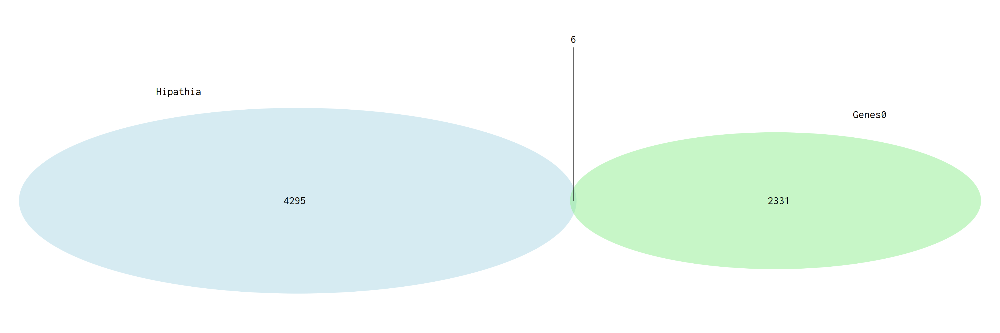

In [26]:
# Find common and unique genes
common_genes <- intersect(hipathia_genes, genes0)
only_in_hipathia <- setdiff(hipathia_genes, genes0) ## Here I have to save it somewhere to recheck again !
only_in_genes0 <- setdiff(genes0, hipathia_genes)
do_venn_diagram(hipathia_genes, genes0) %>% grid.draw(.)

Great! The intersection between the lowly expressed genes across all cancers and Hipathia is **6 genes**, so we can safely remove the other genes (2331 out of 2337 genes) that have a count of 0 in all samples.

In [27]:
hipathia_null_genes_table<-hipathia_genes_table %>% filter(ensembl_gene_id_version %in% common_genes)

These genes will be saved to be tracked in the downstream analysis, allowing for more accurate results.

In [28]:
write.table(x = hipathia_null_genes_table, file = file.path(my_dir, paste0("hipathia_null_genes_",version_of_data,".tsv")), sep = "\t", quote = F,row.names = F, col.names = T)

In [29]:
countdata_list <- lapply(countdata_list, function(d){
    d %>% filter(!rn %in% only_in_genes0)
})

In [30]:
get_object_size()

Object,Size
<chr>,<chr>
countdata_list,1613.7 Mb
get_info_counts,1 Mb
metadata_list,0.7 Mb
hipathia_genes,0.4 Mb
hipathia_genes_table,0.4 Mb
only_in_hipathia,0.4 Mb
genes0,0.2 Mb
only_in_genes0,0.2 Mb
change_label,0.1 Mb


In [ ]:
rm(hipathia_null_genes_table, hipathia_genes_table,only_in_hipathia, only_in_genes0, hipathia_genes, do_venn_diagram, genes0,get_info_counts)

In [36]:
get_object_size()%>%head

,Object,Size
,<chr>,<chr>
1,countdata_list,1613.7 Mb
2,metadata_list,0.7 Mb
3,change_label,0.1 Mb
4,check_and_install,0.1 Mb
5,get_object_size,0.1 Mb
6,plot_case_vs_samples_per_tissueType,0.1 Mb


### Exploratory analysis

#### Defining batchs and colors

Before proceeding with the analysis, we will define a set of colors for each batch to ensure clarity in visualizations. To accommodate colorblindness, we will use the Okabe-Ito palette, recommended by Okabe & Ito (2008). This palette is the default in base R (version 4.0.0 and later) and is widely recognized for its accessibility and effectiveness in presenting results to a broad audience.

In addition to the Okabe-Ito palette, other colors were carefully selected and tested using the "Let's get color blind" plugin. This tool simulates color deficiency based on the model by Gustavo M. Machado et al. ("A Physiologically-based Model for Simulation of Color Vision Deficiency," IEEE Transactions on Visualization and Computer Graphics, 2009), ensuring accessibility for individuals with color vision deficiencies.

First, let's assign colors for each sample type:

In [37]:
#get batchs, with colors by batch
batchs<- get_batchs(metadata_list)

Check the [TCGA Barcode web page](https://docs.gdc.cancer.gov/Encyclopedia/pages/TCGA_Barcode/) for mor information about Barcode Reading.
Here is the schema of the Creating Barcodes process:

<img src="https://docs.gdc.cancer.gov/Encyclopedia/pages/images/creating_barcodes.png" alt="creating_barcodes" style="display: block; margin-left: auto; margin-right: auto;"/>

The following figure illustrates how metadata identifiers comprise a barcode and shows how to read barcodes. 
A TCGA barcode is composed of a series of identifiers, each uniquely identifying a TCGA data element.

<img src="https://docs.gdc.cancer.gov/Encyclopedia/pages/images/barcode.png" alt="barcode_reading" style="display: block; margin-left: auto; margin-right: auto;"/>

In [38]:
levels(batchs$center)

[1] "07"

According to the [GDC TCGA Code Tables](https://gdc.cancer.gov/resources-tcga-users/tcga-code-tables/center-codes), the code `07` corresponds to the following center:

- **Center Name**: University of North Carolina
- **Center Type**: CGCC
- **Display Name**: UNC

In [39]:
levels(batchs$plate) %>% length # by plate: The number of plates is large, making it challenging to create color-blind friendly visuals. A solution needs to be found.

[1] 178

In [40]:
levels(batchs$tss) %>% length

[1] 373

`summarise()` has grouped output by 'project_id', 'sample_type'. You can
override using the `.groups` argument.


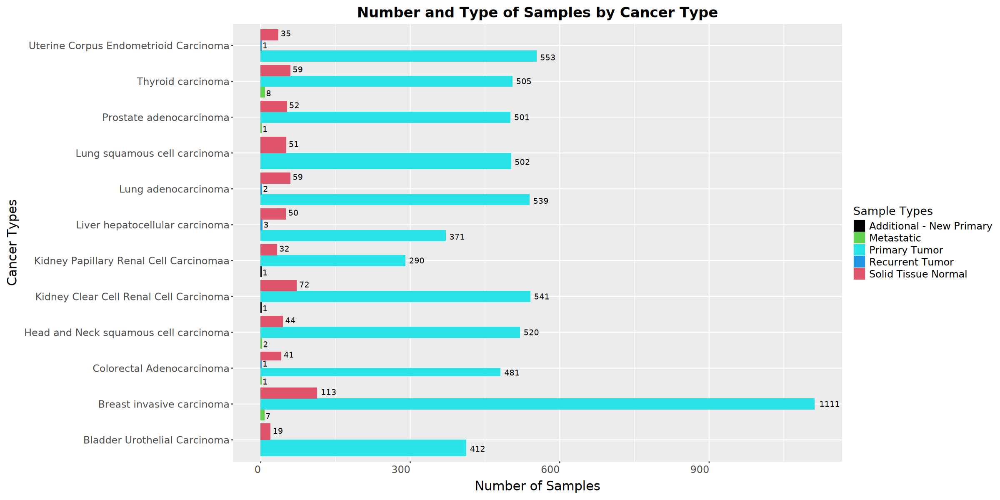

In [41]:
options(repr.plot.width = 20, repr.plot.height = 10)  # Adjust width and height as needed
plot_Samples_Cancer(batchs)

In [42]:
# Save the plot as a PNG file
#ggsave("figures/samplesTypes_per_cancer.png", plot = p, width = 10, height = 8, dpi = 300)

`summarise()` has grouped output by 'project_id', 'groups'. You can override
using the `.groups` argument.


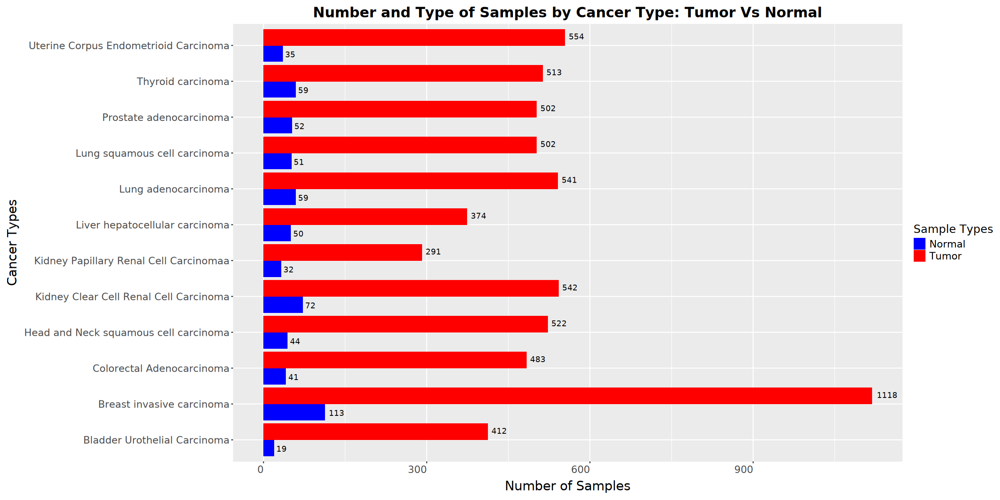

In [43]:
plot_by_tumorVsNormal(batchs)

> **⚠️ Important Notice:**
> 
> The data is **imbalanced**—the number of **Tumor samples** is significantly higher than the **Normal (or control) samples**. This imbalance may affect the analysis and should be carefully considered when interpreting the results.


#### Some plots for row data 

In [44]:
get_object_size() %>% head

,Object,Size
,<chr>,<chr>
1,countdata_list,1613.7 Mb
2,batchs,2 Mb
3,metadata_list,0.7 Mb
4,get_batchs,0.2 Mb
5,change_label,0.1 Mb
6,check_and_install,0.1 Mb


In [45]:
#t_countdata_list <- lapply(countdata_list,transposedt, varlabel="barcode")
#plot_distPerCancer(metadata_list,t_countdata_list) # tobe fixed

#### Principal component analysis for row data cross cancer type

In [47]:
pca_data <- prcomp_list(countdata_list,batchs) %>% do.call(what = rbind, args= .)

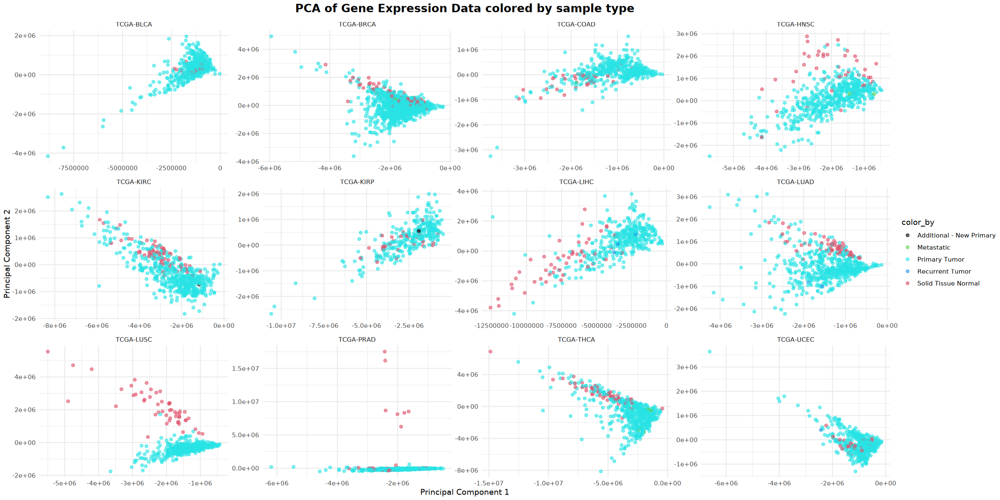

In [48]:
plot_pca_per_cancer(pca_data, color_by= pca_data$sample_type)+ 
    scale_color_manual(values = setNames(batchs$c_by_type, batchs$sample_type))

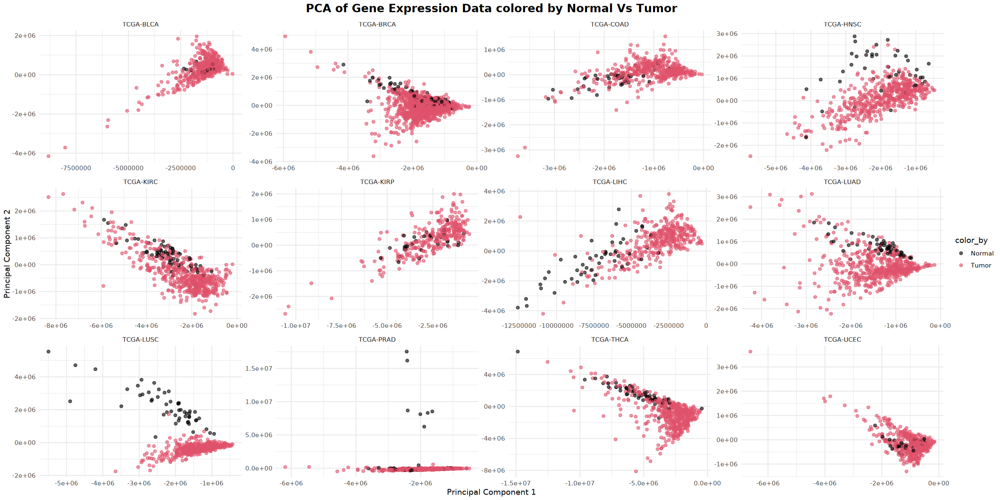

In [49]:
plot_pca_per_cancer(pca_data, color_by= batchs$groups, title = "PCA of Gene Expression Data colored by Normal Vs Tumor") + 
    scale_color_manual(values = setNames(batchs$c_by_group, batchs$groups))

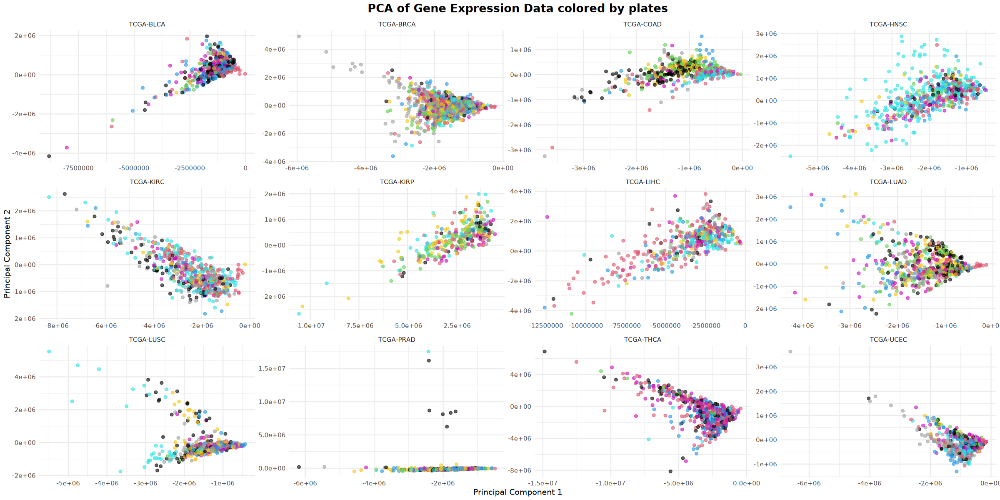

In [50]:
plot_pca_per_cancer(pca_data, color_by= pca_data$plate, title = "PCA of Gene Expression Data colored by plates")+ theme(legend.position = "none") + 
    scale_color_manual(values = setNames(batchs$c_by_plate, batchs$plate))

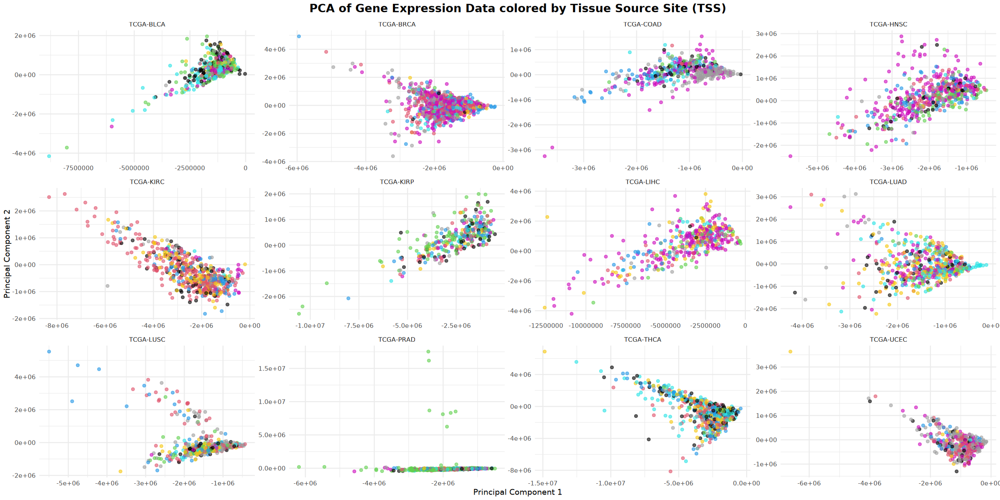

In [51]:
plot_pca_per_cancer(pca_data, color_by= pca_data$tss, title = "PCA of Gene Expression Data colored by Tissue Source Site (TSS)")+ theme(legend.position = "none")+ 
    scale_color_manual(values = setNames(batchs$c_by_tss, batchs$tss))

#### TMM per subtypes of tissues

In [52]:
#plotMDS(data2plot_per_project_list$`TCGA-KIRC`[,-1])

In [53]:
dge_list <- do_normalization_byList(countdata_list,batchs,method ="TMM", group_col = "sample_type") 

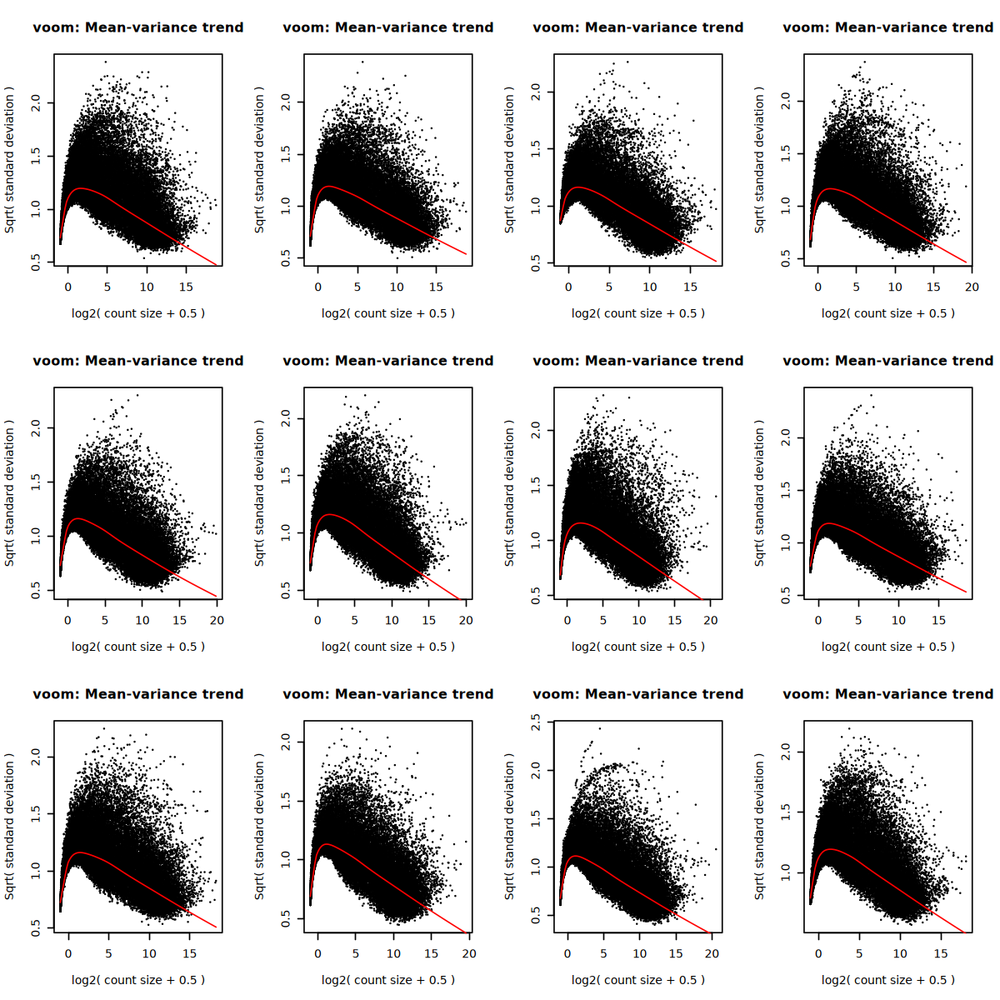

In [55]:
options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as needed
par(mfrow = c(3, 4))
v_list<-lapply(dge_list,voom,plot = T) # http://www.genomebiology.com/2014/15/2/R29
options(repr.plot.width = 30, repr.plot.height = 10)  # Adjust width and height as needed

In [56]:
logCPM_list <- get_logCPM(dge_list,log=TRUE)

#### PCA for TMM as a QC

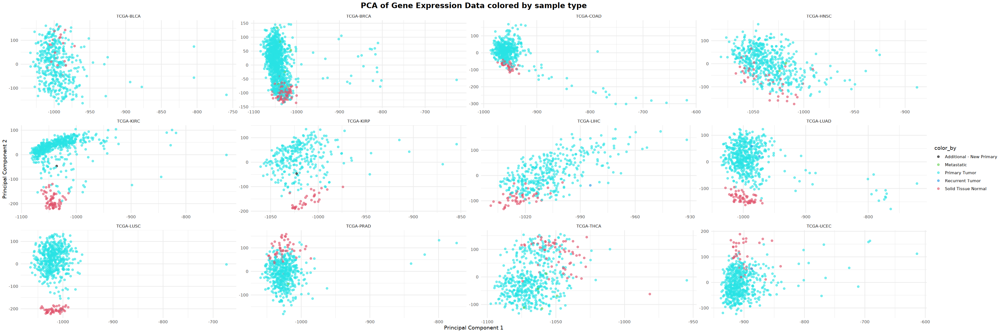

In [57]:
pca_logCPM <- prcomp_list(logCPM_list,batchs) %>% do.call(what = rbind, args= .)
plot_pca_per_cancer(pca_logCPM, color_by= pca_logCPM$sample_type)+ 
    scale_color_manual(values = setNames(batchs$c_by_type, batchs$sample_type))

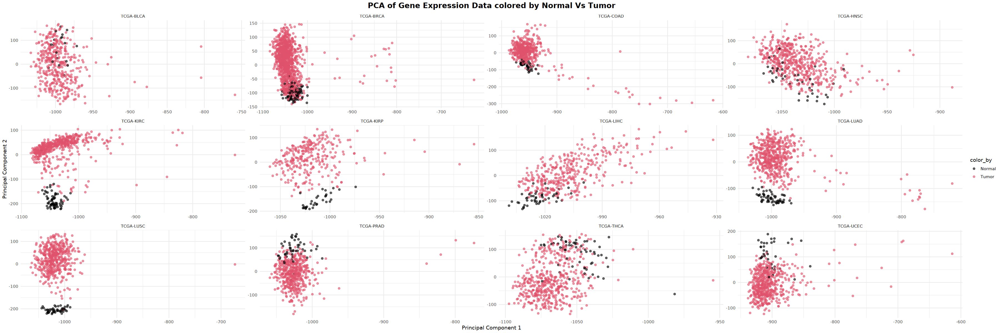

In [58]:
plot_pca_per_cancer(pca_logCPM, color_by= batchs$groups, title = "PCA of Gene Expression Data colored by Normal Vs Tumor") + 
    scale_color_manual(values = setNames(batchs$c_by_group, batchs$groups))

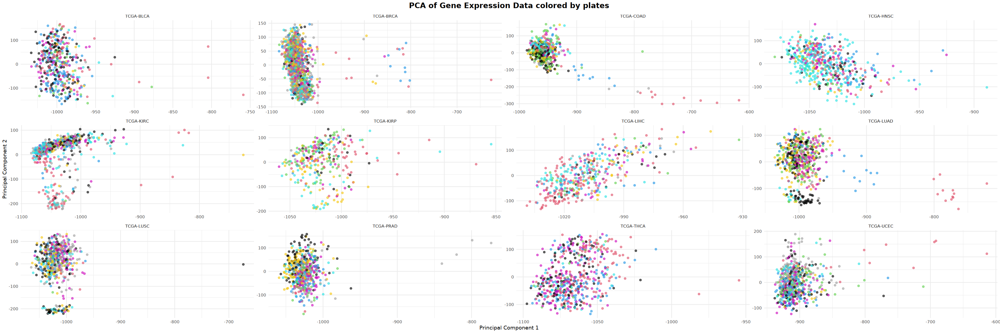

In [59]:
plot_pca_per_cancer(pca_logCPM, color_by= pca_logCPM$plate, title = "PCA of Gene Expression Data colored by plates")+ theme(legend.position = "none") + 
    scale_color_manual(values = setNames(batchs$c_by_plate, batchs$plate))

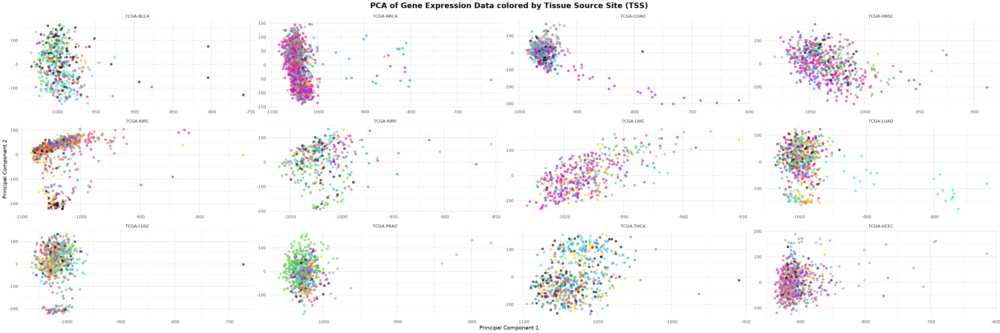

In [60]:
plot_pca_per_cancer(pca_logCPM, color_by= pca_logCPM$tss, title = "PCA of Gene Expression Data colored by Tissue Source Site (TSS)")+ theme(legend.position = "none")+ 
    scale_color_manual(values = setNames(batchs$c_by_tss, batchs$tss))

> **Note:** While performing the TMM (Trimmed Mean of M-values) normalization, two scenarios were considered:
> 
> 1. The groups were based on tissue subtypes (e.g., metastatic, primary tumor) being considered separately.
> 2. The samples were grouped into broader categories, where all subtypes were grouped under the "tumor" category, and only a distinction between "tumor" and "normal" samples was made.
> 
> as a result of these two approaches, the expression matrix after normalization remains the same in both cases, as no effect of subtype stratification was dectect on the normalization step. in either scenario during the normalization process.


#### Principal Component Analysis for normalized data

In [61]:
logCPM_list_file<-file.path(my_dir,paste0("logCPM_list_file_",version_of_data,".rds"))
saveRDS(object = logCPM_list, file = logCPM_list_file)

In [62]:
# chekc the data here

In [63]:
merged_count_data <-cbind_dt_list(countdata_list)

In [64]:
merged_normalized_data <-cbind_dt_list(logCPM_list)

In [ ]:
class(merged_count_data)
head(merged_count_data)
#colnames(merged_count_data)

In [66]:
pca_count_data <- stats::prcomp(t(merged_count_data[,-1]), scale = F,center = F)

In [67]:
pca_normalized <- stats::prcomp(t(merged_normalized_data[,-1]), scale = F,center = F)

In [68]:
pca_countX <- as.data.table(pca_count_data$x)

In [69]:
pca_normalizedX <- as.data.table(pca_normalized$x)

**PCA Plots of Samples to Discover Batch Effects**


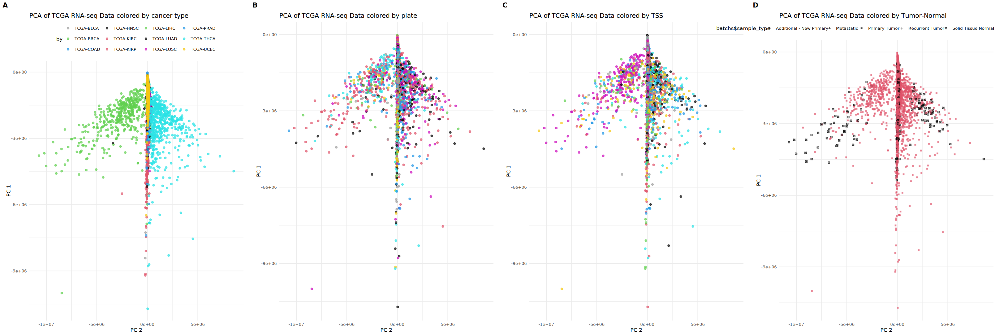

In [70]:
plot_PCAs(pca_countX, batchs)

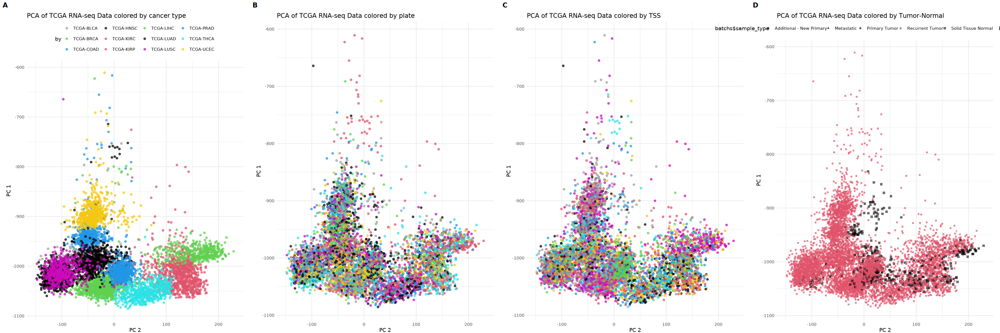

In [71]:
plot_PCAs(pca_normalizedX, batchs)

Principal Component Analysis (PCA) was performed to detect possible batch effects in the RNA-seq counts for 12 cancer types. The PCA plots are colored by various variables to reveal potential sources of variation:

- **Panel A**: Samples are colored by cancer type. This plot reveals the distribution of samples across different cancer types and highlights clustering based on cancer type.

- **Panel B**: Samples are colored by plate. This panel shows a 'clear' batch effect, with distinct clustering of samples from different plates, indicating potential technical variation related to the processing plates.

- **Panel C**: Samples are colored by Tissue Source Site (TSS). This plot provides insight into how TSS affects sample distribution and helps identify any associated batch effects.

- **Panel D**: Samples are colored by normal versus tumor status. This panel illustrates the separation between normal and tumor samples and helps assess whether batch effects might obscure or mimic biological differences.

A clear batch effect was identified in the plots for cancer type and plate. To address and correct these batch effects, the COMBAT algorithm will be applied. COMBAT is a statistical technique used to adjust for batch effects in high-dimensional data, ensuring that the observed biological variations are not confounded by technical artifacts. This adjustment corrects for batch effects related to both the plate and cancer types, facilitating a more accurate comparison of overall tumor data rather than specific tumor types.


### Remove batch effect using COMBAT:

After normalization we need to check for bach effect and then removing it if needed, because normalization does not remove batch effects, which affect specific subsets of genes and may affect different genes in different ways [https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3880143/]

In [72]:
my_mod <-model.matrix(~as.factor(groups), data=batchs)

In [74]:
var.data <- apply(merged_normalized_data[,-1], 1, var)
data4combat_filtered <- merged_normalized_data[which(var.data != 0 ),]  # Maria P and Mrin mentioned: We removed entries with zero variance because including them would cause COMBAT to fail.

In [81]:
var.data %>% summary

    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
 0.08676  0.21392  0.56164  1.22636  1.32804 32.96942 

In [79]:
dim(data4combat_filtered[,-1])

[1] 58329  6981

In [77]:
dim(merged_normalized_data[,-1])

[1] 58329  6981

> **Important Note**: The removed information needs to be reconsidered. Removing genes with zero variance before applying COMBAT and then imputing them for Pathway Activity analysis introduces an additional layer of potential inaccuracy. These genes do not vary, and their imputation could misslead the analysis. (**NOTHING WERE REMOVED !**)


In [82]:
# Apply ComBat for plate BE
combat4plate <- sva::ComBat(dat = merged_normalized_data[,-1],
                 mod = my_mod,
                  batch = batchs$plate, 
                  par.prior = TRUE, 
                  prior.plots = FALSE)  # Suppress plotting

Found 23922 genes with uniform expression within a single batch (all zeros); these will not be adjusted for batch.


Using the 'mean only' version of ComBat

Found178batches

Note: one batch has only one sample, setting mean.only=TRUE

Adjusting for1covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data




In [89]:
dim(merged_normalized_data[,-1])

[1] 58329  6981

In [90]:
dim(combat4plate)

[1] 58329  6981

In [91]:
head(combat4plate)

TCGA-BLCA.TCGA-CU-A3KJ-01A-11R-A21D-07,TCGA-BLCA.TCGA-K4-A3WU-01B-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IU-01A-11R-A20F-07,TCGA-BLCA.TCGA-GV-A40G-01A-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IN-01A-11R-A20F-07,TCGA-BLCA.TCGA-SY-A9G0-01A-12R-A38B-07,TCGA-BLCA.TCGA-XF-A9SU-01A-31R-A39I-07,TCGA-BLCA.TCGA-UY-A78O-01A-12R-A33J-07,TCGA-BLCA.TCGA-GD-A2C5-01A-12R-A180-07,TCGA-BLCA.TCGA-G2-A2EK-01A-22R-A18C-07,⋯,TCGA-UCEC.TCGA-E6-A1LX-01A-11R-A14D-07,TCGA-UCEC.TCGA-FI-A3PV-01A-11R-A22K-07,TCGA-UCEC.TCGA-BG-A0MT-01A-11R-A104-07,TCGA-UCEC.TCGA-EY-A549-01A-11R-A27V-07,TCGA-UCEC.TCGA-D1-A1O7-01A-11R-A14D-07,TCGA-UCEC.TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-UCEC.TCGA-BK-A0C9-01A-11R-A00V-07,TCGA-UCEC.TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-UCEC.TCGA-AP-A05J-01A-11R-A00V-07,TCGA-UCEC.TCGA-D1-A103-01A-11R-A10J-07
5.667448,8.491573,4.062396,7.648249,6.659637,5.579963,6.965262,8.114996,7.569854,8.233744,⋯,5.272579,6.6572916,6.554263,6.310736,6.629957,6.839850,5.628924,7.109832,6.361204,6.080712
-4.147907,-1.372953,-3.713166,-3.099971,-4.204261,-2.179601,-2.999680,-3.799766,-3.672981,-4.094614,⋯,-3.509750,-4.5633311,-2.915424,-3.424957,-3.624429,-3.529995,-3.654775,-2.154001,-0.768419,-3.631352
5.879755,5.127999,5.701277,5.764180,4.657800,5.489051,5.650628,6.182716,5.570483,5.694698,⋯,4.944719,5.3346419,4.969617,5.109477,4.357961,5.024670,3.403225,5.519378,4.148964,4.255326
3.578146,4.562290,3.643068,4.046311,3.725897,3.726396,2.465567,3.539136,4.516733,4.193857,⋯,3.447282,3.4959761,4.199439,4.668052,2.777284,3.687770,3.755970,4.095718,2.698562,3.537804
4.191013,4.391384,3.574144,3.005857,4.636430,3.003469,2.456102,3.043248,4.224812,2.863929,⋯,2.871428,2.6770370,3.589796,2.043183,2.307135,3.050835,2.972309,3.733101,2.492515,2.508736
2.438952,3.440620,5.400516,1.902097,2.939534,3.023844,3.083837,2.237102,2.466669,2.589599,⋯,1.242578,0.4407497,2.173327,2.965949,2.748985,3.414149,3.132598,2.067048,1.073637,2.648755


In [ ]:
#chack data after plate batch effect removal
pca_unscaled_uncenterd_combat4plate <- prcomp(t(combat4plate), scale = F, center = F)

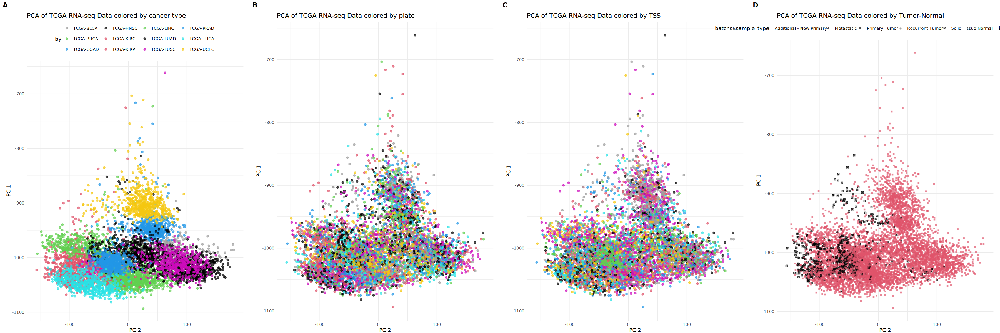

In [115]:
plot_PCAs(as.data.table(pca_unscaled_uncenterd_combat4plate$x), batchs)

> **Important Remark**: Before and after removing batch effects by plate, there is no clear difference observed between the datasets. This step needs to be revisited and redone to ensure proper batch effect correction. Further investigation is required to confirm the effectiveness of the batch effect removal process.


In [93]:
# Apply ComBat for cancer types BE
combat4_plate_and_cancerType <- sva::ComBat(dat=combat4plate, 
                  mod = my_mod,
                  batch=batchs$project_id,
                  par.prior = TRUE, 
                  prior.plots = FALSE)  # Suppress plotting

Found12batches

Adjusting for1covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data




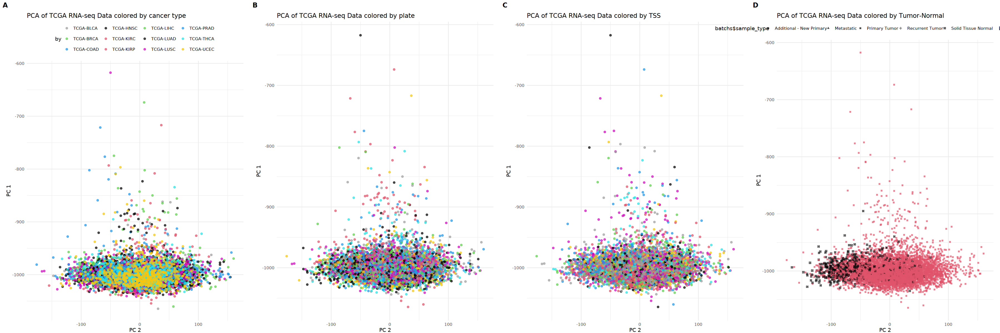

In [94]:
#chack finaly data after plate batch and cancer types  effect removal
pca_unscaled_uncenterd_combat4_plate_and_cancerType <- prcomp(t(combat4_plate_and_cancerType), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_combat4_plate_and_cancerType$x), batchs)

> **Important Remark**: The differences between tumor and control classes are not clearly visible after batch effect correction. This raises concerns that we may be losing important biological effects during the batch effect cleaning process. Further review and re-evaluation are needed to ensure that the biological distinctions between tumor and control samples are accurately preserved and not inadvertently masked by the correction process.


In [95]:
rownames(combat4_plate_and_cancerType) <- merged_normalized_data$rn

In [96]:
head(combat4_plate_and_cancerType)

,TCGA-BLCA.TCGA-CU-A3KJ-01A-11R-A21D-07,TCGA-BLCA.TCGA-K4-A3WU-01B-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IU-01A-11R-A20F-07,TCGA-BLCA.TCGA-GV-A40G-01A-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IN-01A-11R-A20F-07,TCGA-BLCA.TCGA-SY-A9G0-01A-12R-A38B-07,TCGA-BLCA.TCGA-XF-A9SU-01A-31R-A39I-07,TCGA-BLCA.TCGA-UY-A78O-01A-12R-A33J-07,TCGA-BLCA.TCGA-GD-A2C5-01A-12R-A180-07,TCGA-BLCA.TCGA-G2-A2EK-01A-22R-A18C-07,⋯,TCGA-UCEC.TCGA-E6-A1LX-01A-11R-A14D-07,TCGA-UCEC.TCGA-FI-A3PV-01A-11R-A22K-07,TCGA-UCEC.TCGA-BG-A0MT-01A-11R-A104-07,TCGA-UCEC.TCGA-EY-A549-01A-11R-A27V-07,TCGA-UCEC.TCGA-D1-A1O7-01A-11R-A14D-07,TCGA-UCEC.TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-UCEC.TCGA-BK-A0C9-01A-11R-A00V-07,TCGA-UCEC.TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-UCEC.TCGA-AP-A05J-01A-11R-A00V-07,TCGA-UCEC.TCGA-D1-A103-01A-11R-A10J-07
ENSG00000000003.15,5.240923,7.2829385,4.080372,6.673164,5.958337,5.177666,6.179322,7.010650,6.616479,7.096513,⋯,4.841792,6.408050,6.291513,6.016058,6.377131,6.614543,5.244857,6.919921,6.07314351,5.755877
ENSG00000000005.6,-3.824657,-0.3473206,-3.279875,-2.511472,-3.895275,-1.358143,-2.385796,-3.388396,-3.229519,-3.757873,⋯,-3.267034,-4.490457,-2.576900,-3.168572,-3.400200,-3.290543,-3.435438,-1.692732,-0.08378953,-3.408239
ENSG00000000419.13,5.424674,4.7260632,5.258813,5.317270,4.289103,5.061591,5.211746,5.706218,5.137266,5.252700,⋯,5.205149,5.504302,5.224252,5.331553,4.754983,5.266489,4.022501,5.646033,4.59463864,4.676241
ENSG00000000457.14,3.633643,4.4720291,3.688951,4.032470,3.759512,3.759937,2.685845,3.600412,4.433219,4.158163,⋯,3.675643,3.714771,4.280032,4.656581,3.137272,3.868885,3.923686,4.196688,3.07401623,3.748381
ENSG00000000460.17,3.306594,3.4591858,2.836821,2.404045,3.645799,2.402227,1.985382,2.432520,3.332333,2.295960,⋯,2.886295,2.708516,3.543275,2.128827,2.370223,3.050370,2.978555,3.674334,2.53976206,2.554597
ENSG00000000938.13,2.401667,3.3609718,5.237980,1.887517,2.881078,2.961823,3.019278,2.208354,2.428211,2.545943,⋯,1.987255,1.250138,2.842889,3.571543,3.372089,3.983571,3.724744,2.745188,1.83194884,3.279948


Found12batches

Adjusting for1covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data




Found 23894 genes with uniform expression within a single batch (all zeros); these will not be adjusted for batch.


Using the 'mean only' version of ComBat

Found178batches

Note: one batch has only one sample, setting mean.only=TRUE

Adjusting for1covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data




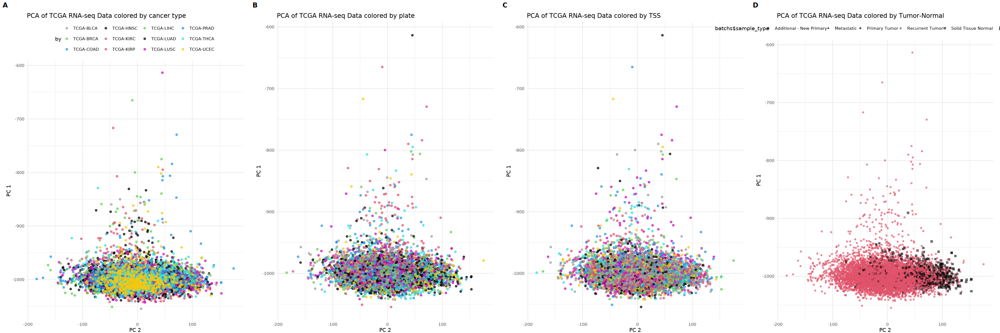

In [97]:
################To detleted: just to check how data if we start with removing cancer type batch effect:
suppressPackageStartupMessages(library(sva))
#combat CANCER
combat_pre2 <- ComBat(dat=merged_normalized_data[,-1], batch=batchs$project_id,
                  mod = my_mod,
                  par.prior = TRUE, 
                  prior.plots = FALSE)  # Suppress plotting
#combat PLATE
combat_pre3 <- ComBat(dat=combat_pre2, batch=batchs$plate,
                  mod = my_mod,
                  par.prior = TRUE, 
                  prior.plots = FALSE)  # Suppress plotting
#PCA
pca_unscaled_uncenterd_combat_pre2 <- prcomp(t(combat_pre3), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_combat_pre2$x), batchs)

In [98]:
head(combat4_plate_and_cancerType)

,TCGA-BLCA.TCGA-CU-A3KJ-01A-11R-A21D-07,TCGA-BLCA.TCGA-K4-A3WU-01B-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IU-01A-11R-A20F-07,TCGA-BLCA.TCGA-GV-A40G-01A-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IN-01A-11R-A20F-07,TCGA-BLCA.TCGA-SY-A9G0-01A-12R-A38B-07,TCGA-BLCA.TCGA-XF-A9SU-01A-31R-A39I-07,TCGA-BLCA.TCGA-UY-A78O-01A-12R-A33J-07,TCGA-BLCA.TCGA-GD-A2C5-01A-12R-A180-07,TCGA-BLCA.TCGA-G2-A2EK-01A-22R-A18C-07,⋯,TCGA-UCEC.TCGA-E6-A1LX-01A-11R-A14D-07,TCGA-UCEC.TCGA-FI-A3PV-01A-11R-A22K-07,TCGA-UCEC.TCGA-BG-A0MT-01A-11R-A104-07,TCGA-UCEC.TCGA-EY-A549-01A-11R-A27V-07,TCGA-UCEC.TCGA-D1-A1O7-01A-11R-A14D-07,TCGA-UCEC.TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-UCEC.TCGA-BK-A0C9-01A-11R-A00V-07,TCGA-UCEC.TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-UCEC.TCGA-AP-A05J-01A-11R-A00V-07,TCGA-UCEC.TCGA-D1-A103-01A-11R-A10J-07
ENSG00000000003.15,5.240923,7.2829385,4.080372,6.673164,5.958337,5.177666,6.179322,7.010650,6.616479,7.096513,⋯,4.841792,6.408050,6.291513,6.016058,6.377131,6.614543,5.244857,6.919921,6.07314351,5.755877
ENSG00000000005.6,-3.824657,-0.3473206,-3.279875,-2.511472,-3.895275,-1.358143,-2.385796,-3.388396,-3.229519,-3.757873,⋯,-3.267034,-4.490457,-2.576900,-3.168572,-3.400200,-3.290543,-3.435438,-1.692732,-0.08378953,-3.408239
ENSG00000000419.13,5.424674,4.7260632,5.258813,5.317270,4.289103,5.061591,5.211746,5.706218,5.137266,5.252700,⋯,5.205149,5.504302,5.224252,5.331553,4.754983,5.266489,4.022501,5.646033,4.59463864,4.676241
ENSG00000000457.14,3.633643,4.4720291,3.688951,4.032470,3.759512,3.759937,2.685845,3.600412,4.433219,4.158163,⋯,3.675643,3.714771,4.280032,4.656581,3.137272,3.868885,3.923686,4.196688,3.07401623,3.748381
ENSG00000000460.17,3.306594,3.4591858,2.836821,2.404045,3.645799,2.402227,1.985382,2.432520,3.332333,2.295960,⋯,2.886295,2.708516,3.543275,2.128827,2.370223,3.050370,2.978555,3.674334,2.53976206,2.554597
ENSG00000000938.13,2.401667,3.3609718,5.237980,1.887517,2.881078,2.961823,3.019278,2.208354,2.428211,2.545943,⋯,1.987255,1.250138,2.842889,3.571543,3.372089,3.983571,3.724744,2.745188,1.83194884,3.279948


In [99]:
head(combat_pre3)

TCGA-BLCA.TCGA-CU-A3KJ-01A-11R-A21D-07,TCGA-BLCA.TCGA-K4-A3WU-01B-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IU-01A-11R-A20F-07,TCGA-BLCA.TCGA-GV-A40G-01A-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IN-01A-11R-A20F-07,TCGA-BLCA.TCGA-SY-A9G0-01A-12R-A38B-07,TCGA-BLCA.TCGA-XF-A9SU-01A-31R-A39I-07,TCGA-BLCA.TCGA-UY-A78O-01A-12R-A33J-07,TCGA-BLCA.TCGA-GD-A2C5-01A-12R-A180-07,TCGA-BLCA.TCGA-G2-A2EK-01A-22R-A18C-07,⋯,TCGA-UCEC.TCGA-E6-A1LX-01A-11R-A14D-07,TCGA-UCEC.TCGA-FI-A3PV-01A-11R-A22K-07,TCGA-UCEC.TCGA-BG-A0MT-01A-11R-A104-07,TCGA-UCEC.TCGA-EY-A549-01A-11R-A27V-07,TCGA-UCEC.TCGA-D1-A1O7-01A-11R-A14D-07,TCGA-UCEC.TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-UCEC.TCGA-BK-A0C9-01A-11R-A00V-07,TCGA-UCEC.TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-UCEC.TCGA-AP-A05J-01A-11R-A00V-07,TCGA-UCEC.TCGA-D1-A103-01A-11R-A10J-07
5.238161,7.2387378,4.069827,6.623498,5.964624,5.149559,6.208320,6.973849,6.667808,7.118220,⋯,4.648308,6.538783,6.522158,5.847490,6.249317,6.754108,5.516100,6.790012,6.3798144,5.660345
-3.970997,-0.6310536,-3.346015,-2.764622,-3.952718,-1.741980,-2.339974,-3.254568,-2.916656,-3.946919,⋯,-3.211319,-4.237089,-2.608840,-3.811578,-3.345573,-3.027368,-2.940664,-2.323675,0.4383793,-3.364267
5.404524,4.6698790,5.251353,5.271146,4.265141,4.944996,5.252229,5.669376,5.147714,5.239577,⋯,5.268608,5.600456,5.128976,5.261239,4.845627,5.377004,4.053155,5.556729,4.5907421,4.786749
3.645334,4.4369364,3.698872,3.998578,3.769240,3.671195,2.676304,3.591198,4.477039,4.137900,⋯,3.704297,3.755691,4.312535,4.504518,3.157500,3.912217,3.909974,4.037427,3.0470054,3.786487
3.219324,3.2630730,2.806984,2.200830,3.621407,2.287604,2.051200,2.399760,3.353775,2.153414,⋯,2.884372,2.798618,3.518298,1.898284,2.371175,3.138568,3.107253,3.435181,2.6709042,2.561152
2.361188,3.3817664,5.259571,1.897793,2.885844,2.715382,3.058456,2.160464,2.505857,2.533101,⋯,2.035387,1.330315,2.886993,3.236559,3.435660,4.094222,3.632679,2.400991,1.7187827,3.324470


In [100]:
errs<-(combat_pre3-combat4_plate_and_cancerType)

In [101]:
max(combat4_plate_and_cancerType)

[1] 42.58142

In [102]:
max(errs)

[1] 10.37024

In [103]:
min(errs)

[1] -9.967906

In [104]:
summary(combat4_plate_and_cancerType[,1])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-5.5967 -4.6297 -3.7541 -1.7503  0.2126 12.5609 

In [105]:
summary(combat_pre3[,1])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
-5.9419 -4.6336 -3.7858 -1.7612  0.2064 12.6339 

In [106]:
summary(errs[,1])

      Min.    1st Qu.     Median       Mean    3rd Qu.       Max. 
-0.8779105 -0.0399806 -0.0000189 -0.0108851  0.0002207  1.5615910 

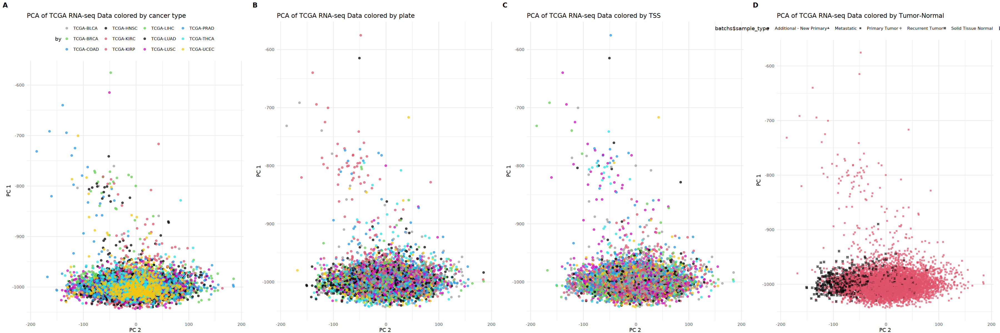

In [117]:
# Here a pca again :P for data after only camner type batch effect removal :
pca_unscaled_uncenterd_combat_CancerType <- prcomp(t(combat_pre2), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_combat_CancerType$x), batchs)

#### PCAs after normalization & Batcheffect

###### PCA of row data:

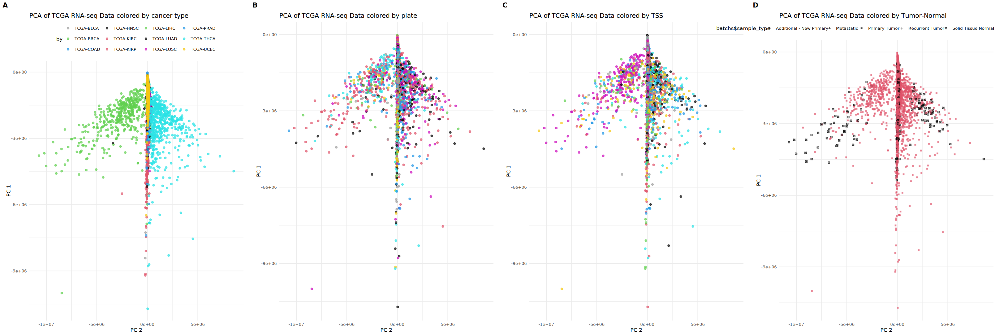

In [107]:
plot_PCAs(pca_countX, batchs)

###### PCA of normalized data:

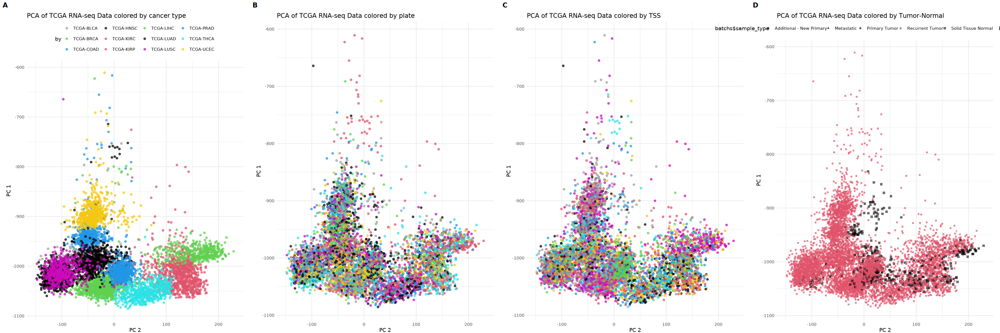

In [108]:
plot_PCAs(pca_normalizedX, batchs)

###### PCA of normalized+combat data, without scaling or centering:

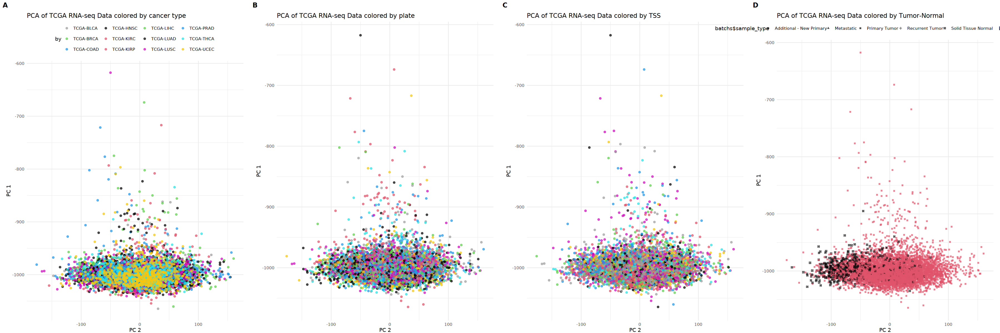

In [119]:
plot_PCAs(as.data.table(pca_unscaled_uncenterd_combat4_plate_and_cancerType$x), batchs)

###### PCA of normalized+combat data, per cancer:

In [110]:
class(logCPM_list$`TCGA-BLCA`)

[1] "data.table" "data.frame"

In [111]:
class(combat4_plate_and_cancerType)

[1] "matrix" "array"

In [112]:
head(combat4_plate_and_cancerType)

,TCGA-BLCA.TCGA-CU-A3KJ-01A-11R-A21D-07,TCGA-BLCA.TCGA-K4-A3WU-01B-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IU-01A-11R-A20F-07,TCGA-BLCA.TCGA-GV-A40G-01A-11R-A23N-07,TCGA-BLCA.TCGA-DK-A3IN-01A-11R-A20F-07,TCGA-BLCA.TCGA-SY-A9G0-01A-12R-A38B-07,TCGA-BLCA.TCGA-XF-A9SU-01A-31R-A39I-07,TCGA-BLCA.TCGA-UY-A78O-01A-12R-A33J-07,TCGA-BLCA.TCGA-GD-A2C5-01A-12R-A180-07,TCGA-BLCA.TCGA-G2-A2EK-01A-22R-A18C-07,⋯,TCGA-UCEC.TCGA-E6-A1LX-01A-11R-A14D-07,TCGA-UCEC.TCGA-FI-A3PV-01A-11R-A22K-07,TCGA-UCEC.TCGA-BG-A0MT-01A-11R-A104-07,TCGA-UCEC.TCGA-EY-A549-01A-11R-A27V-07,TCGA-UCEC.TCGA-D1-A1O7-01A-11R-A14D-07,TCGA-UCEC.TCGA-AJ-A3NF-01A-11R-A22K-07,TCGA-UCEC.TCGA-BK-A0C9-01A-11R-A00V-07,TCGA-UCEC.TCGA-AJ-A5DW-01A-11R-A27V-07,TCGA-UCEC.TCGA-AP-A05J-01A-11R-A00V-07,TCGA-UCEC.TCGA-D1-A103-01A-11R-A10J-07
ENSG00000000003.15,5.240923,7.2829385,4.080372,6.673164,5.958337,5.177666,6.179322,7.010650,6.616479,7.096513,⋯,4.841792,6.408050,6.291513,6.016058,6.377131,6.614543,5.244857,6.919921,6.07314351,5.755877
ENSG00000000005.6,-3.824657,-0.3473206,-3.279875,-2.511472,-3.895275,-1.358143,-2.385796,-3.388396,-3.229519,-3.757873,⋯,-3.267034,-4.490457,-2.576900,-3.168572,-3.400200,-3.290543,-3.435438,-1.692732,-0.08378953,-3.408239
ENSG00000000419.13,5.424674,4.7260632,5.258813,5.317270,4.289103,5.061591,5.211746,5.706218,5.137266,5.252700,⋯,5.205149,5.504302,5.224252,5.331553,4.754983,5.266489,4.022501,5.646033,4.59463864,4.676241
ENSG00000000457.14,3.633643,4.4720291,3.688951,4.032470,3.759512,3.759937,2.685845,3.600412,4.433219,4.158163,⋯,3.675643,3.714771,4.280032,4.656581,3.137272,3.868885,3.923686,4.196688,3.07401623,3.748381
ENSG00000000460.17,3.306594,3.4591858,2.836821,2.404045,3.645799,2.402227,1.985382,2.432520,3.332333,2.295960,⋯,2.886295,2.708516,3.543275,2.128827,2.370223,3.050370,2.978555,3.674334,2.53976206,2.554597
ENSG00000000938.13,2.401667,3.3609718,5.237980,1.887517,2.881078,2.961823,3.019278,2.208354,2.428211,2.545943,⋯,1.987255,1.250138,2.842889,3.571543,3.372089,3.983571,3.724744,2.745188,1.83194884,3.279948


###### PCA of normalized+combat data per cancer type:

In [121]:
#preparation of combat4_plate_and_cancerType_list for the pca plot per cancer
combat4_plate_and_cancerType_list<-combat4_plate_and_cancerType %>% t %>% as.data.table %>% mutate(project_id = batchs$project_id)%>% dplyr::group_split(project_id, .keep = FALSE)
names(combat4_plate_and_cancerType_list)<- names(countdata_list)
combat4_plate_and_cancerType_list<-lapply(combat4_plate_and_cancerType_list,t)
combat4_plate_and_cancerType_list<-lapply(names(countdata_list), function(n){
    colnames(combat4_plate_and_cancerType_list[[n]]) <- colnames(countdata_list[[n]][,-1])
    return(combat4_plate_and_cancerType_list[[n]])
    })
names(combat4_plate_and_cancerType_list)<- names(countdata_list)

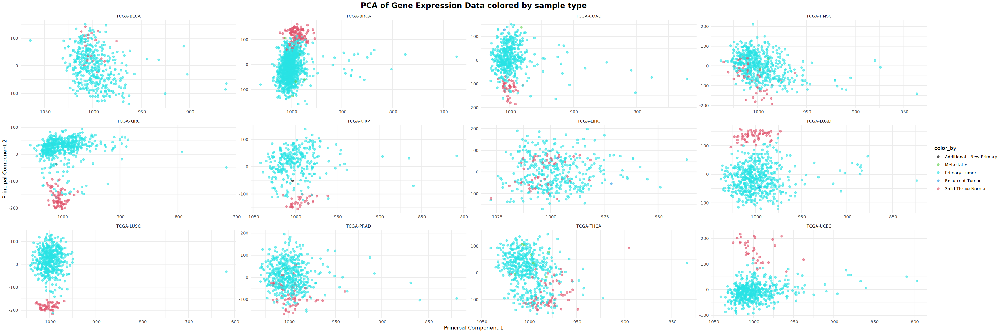

In [122]:
pca_logCPM_combat <- prcomp_list(combat4_plate_and_cancerType_list,batchs) %>% do.call(what = rbind, args= .)
plot_pca_per_cancer(pca_logCPM_combat, color_by= pca_logCPM_combat$sample_type)+ 
    scale_color_manual(values = setNames(batchs$c_by_type, batchs$sample_type))

### Other exploratory plots using different packages for Principal component analysis (Just or tests: to be removed)

In [123]:
res.pca <- PCA(t(combat4_plate_and_cancerType), graph = FALSE, ncp = 4, scale.unit = F)

In [134]:
res.pca_befor <- PCA(t(merged_normalized_data[,-1]), graph = FALSE, ncp = 4, scale.unit = F)

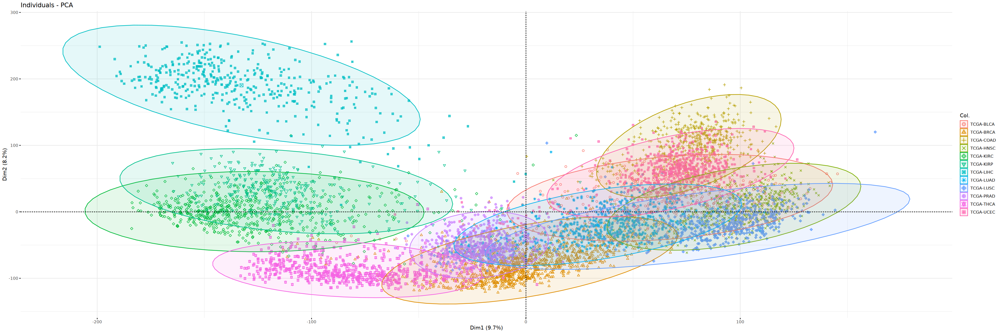

In [135]:
#before:
fviz_pca_ind(res.pca_befor, geom = "point",col.ind = batchs$project_id, addEllipses = T)

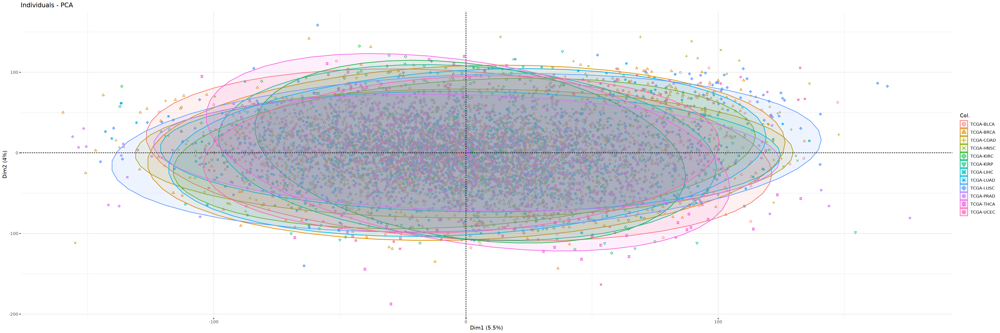

In [125]:
fviz_pca_ind(res.pca, geom = "point",col.ind = batchs$project_id, addEllipses = T)

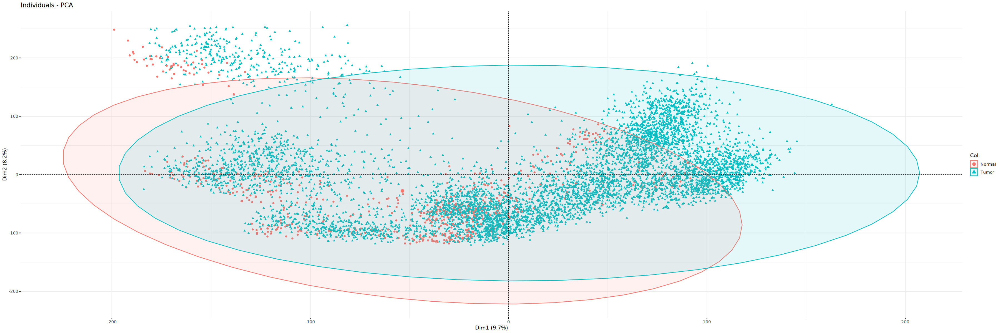

In [136]:
#before
fviz_pca_ind(res.pca_befor, geom = "point",col.ind = batchs$groups, addEllipses = T)

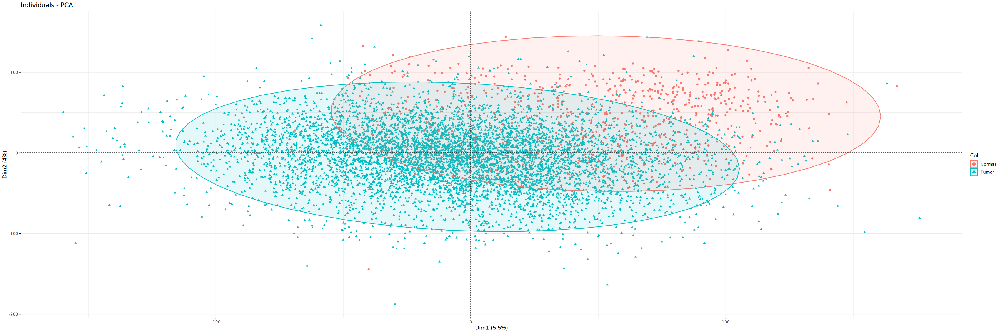

In [127]:
fviz_pca_ind(res.pca, geom = "point",col.ind = batchs$groups, addEllipses = T)

In [128]:
mypca = mixOmics::pca(t(combat4_plate_and_cancerType), ncomp = 5, center = FALSE, scale = FALSE)

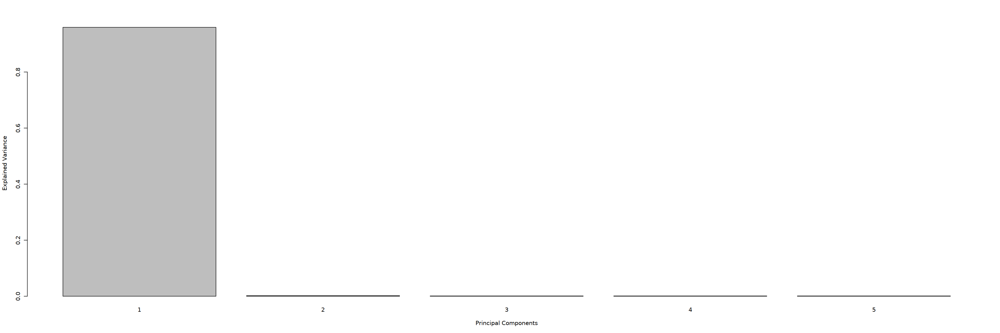

In [129]:
plot(mypca)

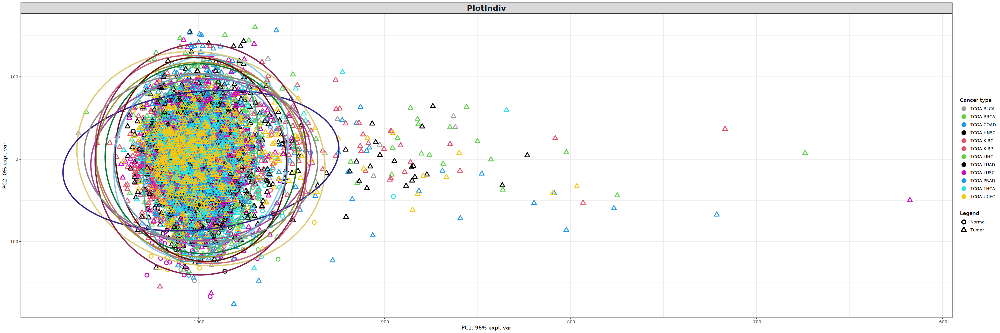

In [130]:
p1<-plotIndiv(mypca, comp = 1:2, 
          #ind.names = batchs$participant,
          pch= batchs$groups,
          group = batchs$project_id,
          # graphical parameters
          col = unique(batchs$c_by_cancer), style = "ggplot2", 
          legend = TRUE, legend.position = "right", 
          legend.title = "Cancer type", ellipse = TRUE, 
          ellipse.level = 0.95, centroid = FALSE)

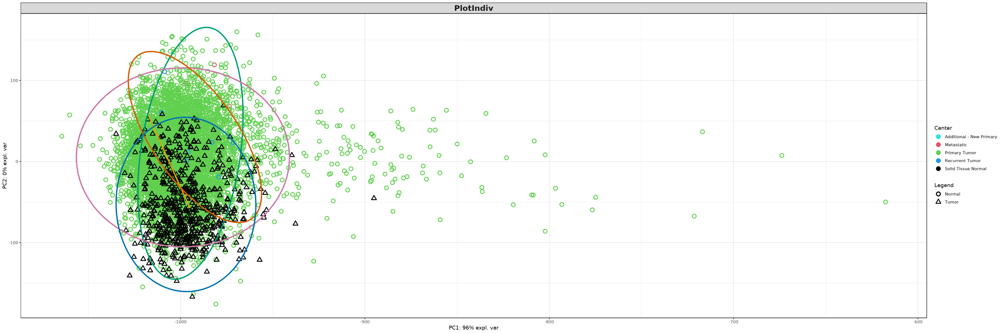

In [131]:
p2<-plotIndiv(mypca, comp = 1:2, 
          #ind.names = batchs$participant,
          pch= batchs$groups,
          group = batchs$sample_type,
          # graphical parameters
          col = unique(batchs$c_by_type), style = "ggplot2", 
          legend = TRUE, legend.position = "right", 
          legend.title = "Center", ellipse = TRUE, 
          ellipse.level = 0.95, centroid = FALSE)

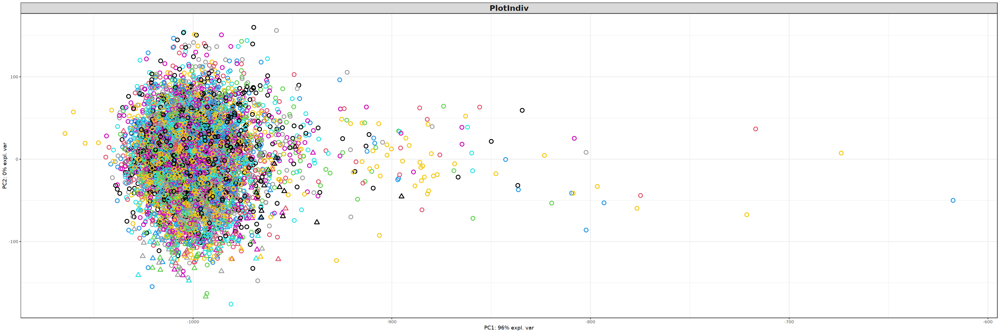

In [132]:
p3<-plotIndiv(mypca, comp = 1:2, 
          #ind.names = batchs$participant,
          pch= batchs$groups,
          group = batchs$plate,
          # graphical parameters
          col = unique(batchs$c_by_plate), 
              style = "ggplot2", 
          legend = F, legend.position = "right", 
          legend.title.pch = "Plate", ellipse = F, 
          ellipse.level = 0.95, centroid = FALSE)

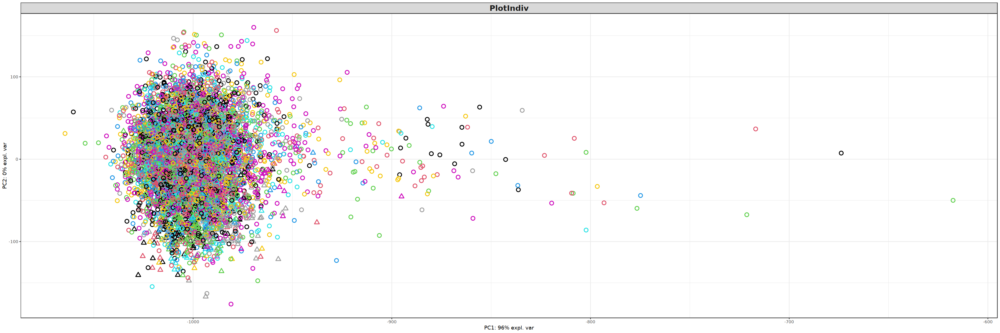

In [133]:
p4<-plotIndiv(mypca, comp = 1:2, 
          #ind.names = batchs$participant,
          pch= batchs$groups,
          group = batchs$tss,
          # graphical parameters
          col = unique(batchs$c_by_tss), style = "ggplot2", 
          legend = F, legend.position = "right", 
          legend.title = "Center", ellipse = F, 
          ellipse.level = 0.95, centroid = FALSE)

## Data preprocessing for breast cancer study

### Data selection

In [ ]:
#check if plat6e used in BRCA are used in other cancer in these data 

In [785]:
platesPerCancers <- batchs %>% dplyr::select(c(plate,project_id)) %>% unique %>% group_by(plate) %>% 
    filter(duplicated(plate) | duplicated(plate, fromLast = T))%>% 
    mutate(usedInCancers = n()) %>% arrange(desc(usedInCancers), plate,project_id, ) 
head(platesPerCancers)

plate,project_id,usedInCancers
<fct>,<fct>,<int>
A180,TCGA-BLCA,6
A180,TCGA-BRCA,6
A180,TCGA-COAD,6
A180,TCGA-LIHC,6
A180,TCGA-THCA,6
A180,TCGA-UCEC,6


In [786]:
message("The number of plate that are used for more than one type of cancer is : ",
platesPerCancers %>% dplyr::select(c(plate, usedInCancers)) %>% unique %>% dim %>% .[1], " Out of a totle of :",
batchs$plate %>% unique %>% length)

The number of plate that are used for more than one type of cancer is : 78 Out of a totle of :178



In [787]:
message("The number of plate that are used for BRCA and more than one type of other cancer is : ",
platesPerCancers %>% filter(project_id=="TCGA-BRCA") %>% unique %>% dim %>% .[1], " Out of a totle of :",
batchs %>% filter(project_id=="TCGA-BRCA") %>% .$plate %>% unique %>% length)

The number of plate that are used for BRCA and more than one type of other cancer is : 33 Out of a totle of :45



In [788]:
# Filter the data keeping only  paired data 113 samples 
brca_count <- countdata_list$`TCGA-BRCA`
brca_batchs <- batchs %>% filter(project_id =="TCGA-BRCA")
paired_patients <- brca_batchs %>% dplyr::select(c(participant, groups)) %>% unique() %>% filter(duplicated(participant)) %>% .$participant

In [789]:
brca_batchs_paired <- brca_batchs %>% filter(participant %in% paired_patients)

In [790]:
brca_batchs_paired %>% filter(participant %in% as.character(brca_batchs_paired %>% filter(sample_type =="Metastatic") %>% .$participant) &
                             groups =="Tumor") %>% dplyr::select( barcode, sample_type, participant) %>% arrange(participant)

,barcode,sample_type,participant
,<chr>,<fct>,<fct>
TCGA-E2-A15K-01A-11R-A12P-07,TCGA-E2-A15K-01A-11R-A12P-07,Primary Tumor,A15K
TCGA-E2-A15K-06A-11R-A12P-07,TCGA-E2-A15K-06A-11R-A12P-07,Metastatic,A15K
TCGA-BH-A18V-01A-11R-A12D-07,TCGA-BH-A18V-01A-11R-A12D-07,Primary Tumor,A18V
TCGA-BH-A18V-06A-11R-A213-07,TCGA-BH-A18V-06A-11R-A213-07,Metastatic,A18V
TCGA-BH-A1FE-01A-11R-A13Q-07,TCGA-BH-A1FE-01A-11R-A13Q-07,Primary Tumor,A1FE
TCGA-BH-A1FE-06A-11R-A213-07,TCGA-BH-A1FE-06A-11R-A213-07,Metastatic,A1FE


>As we can see in the table above, the metastatic patients also have samples from the primary tumor. **I will remove these samples with a metastatic profile**, as they introduce noise in the data (it was showed by a PCA), and there are only three such samples. We will keep other for these patients with primary tumor type

In [791]:
brca_batchs_paired <- brca_batchs_paired %>% filter(sample_type !="Metastatic")

In [793]:
brca_count_paired <- brca_count %>% dplyr::select(all_of(c("rn",brca_batchs_paired$barcode)))

In [795]:
brca_batchs_paired <-droplevels(brca_batchs_paired)

In [796]:
brca_batchs_paired$sample_type %>%table

.
      Primary Tumor Solid Tissue Normal 
                119                 113 

In [797]:
mypca_brca = mixOmics::pca(t(brca_count_paired[,-1]), ncomp = 5, center = FALSE, scale = FALSE)

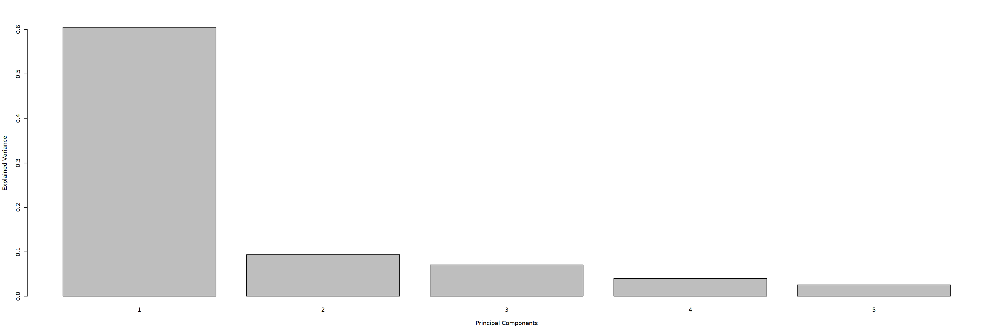

In [798]:
plot(mypca_brca)

>PC1 captures the majority of variance (>60%), indicating a strong underlying factor influencing the dataset. PC2 explains around 10%, with subsequent components (PC3 and beyond) contributing progressively less. This suggests that most of the variability in the BRCA cancer data can be captured by the first two principal components, while further PCs add minimal additional variance.

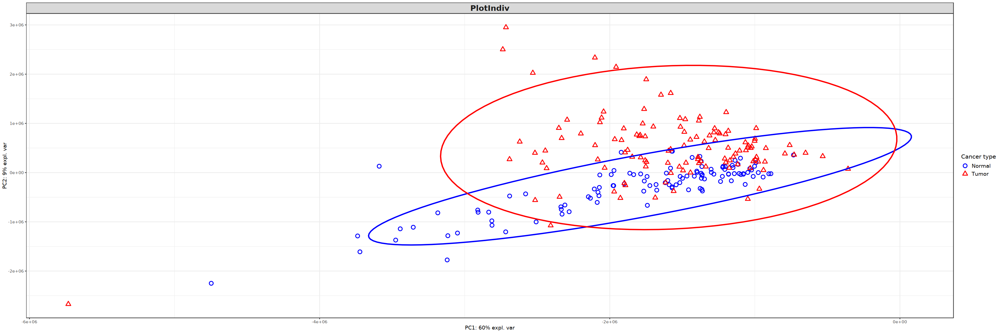

In [800]:
p1<-plotIndiv(mypca_brca, comp = 1:2, col.per.group = levels(brca_batchs_paired$c_by_group), ind.names = 
              FALSE,
          group = brca_batchs_paired$groups,
          # graphical parameters
              style = "ggplot2",
          legend = TRUE, legend.position = "right", 
          legend.title = "Cancer type", 
          legend.title.pch = 'Sample types',              
          legend.pch = FALSE,  # Show point shape in the legend
          ellipse = TRUE, 
          ellipse.level = 0.95)

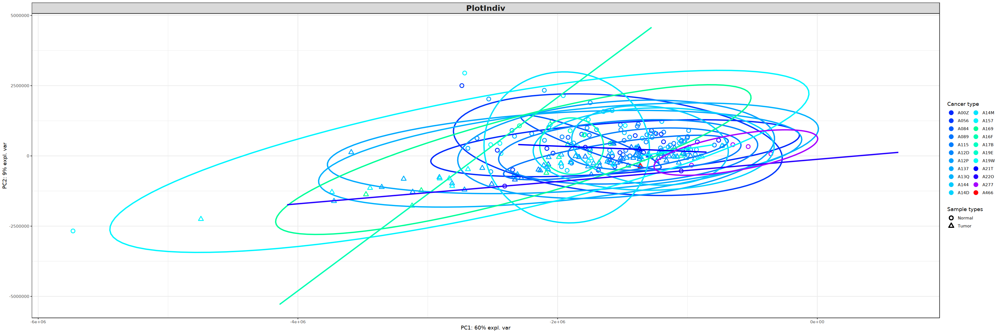

In [801]:
p1<-plotIndiv(mypca_brca, comp = 1:2, col.per.group = levels(brca_batchs_paired$c_by_plate),
          pch= brca_batchs_paired$groups,
          group = brca_batchs_paired$plate,
          # graphical parameters
              style = "ggplot2",
          legend = TRUE, legend.position = "right", 
          legend.title = "Cancer type", 
          legend.title.pch = 'Sample types',
          legend.pch = FALSE,  # Show point shape in the legend
          ellipse = TRUE, 
          ellipse.level = 0.95)

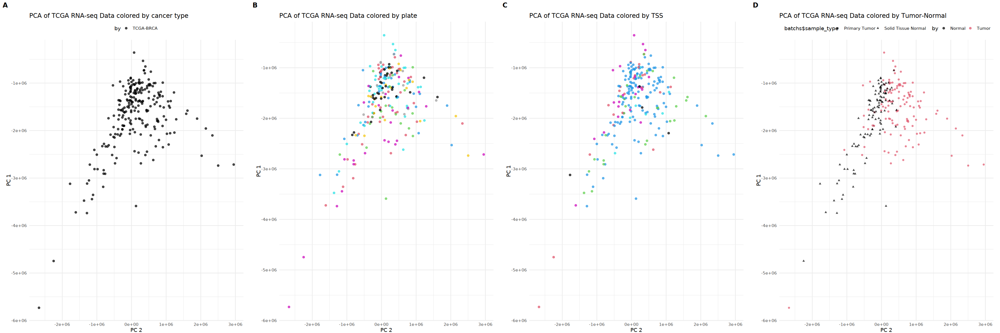

In [802]:
pca_unscaled_uncenterd_brca_count <- prcomp(t(brca_count_paired[,-1]), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_brca_count$x), brca_batchs_paired)

### Quality control
#### Normalization TMM

In [803]:
# Normalization
dge_brca <- do_normalization(brca_count_paired,brca_batchs_paired,method ="TMM", group_col = "sample_type") 
# Log-transformation
logCPM_brca <- cpm(dge_brca, log=TRUE)

In [804]:
rownames(logCPM_brca)<- dge_brca$rn

In [805]:
logCPM_brca <- as.data.table(logCPM_brca, keep.rownames = T)

#### Outliers detection

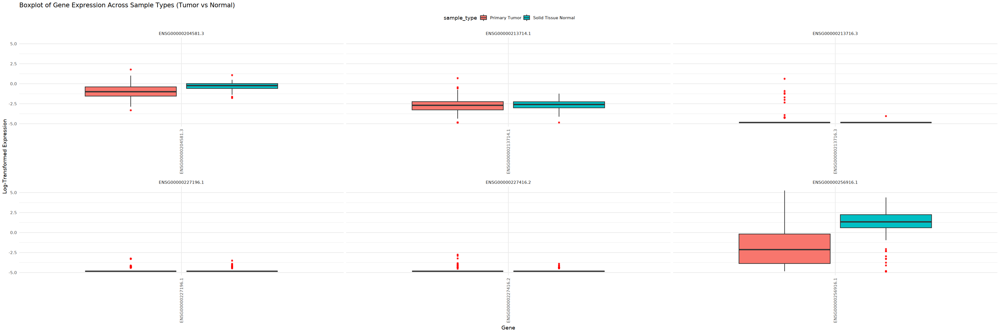

In [828]:
# Boxplot of Randomly selected gene expression across sample types (Tumor vs Normal)
# (I have changed the seed and run it several time ...)
set.seed(261090) # For reproducibility
selected_genes <- sample(logCPM_brca$rn, 6)
# Reshape for ggplot (convert to long format)
logCPM_brca_long <- melt(logCPM_brca,id.vars = "rn", variable.name = "Sample", value.name = "Expression") %>%
    mutate(sample_type= brca_batchs_paired$sample_type[Sample])

ggplot(logCPM_brca_long %>% filter(rn %in% selected_genes) , aes(x = rn, y = Expression, fill = sample_type)) +
  geom_boxplot(outlier.colour = "red", outlier.shape = 8, outlier.size = 1) +
  labs(title = "Boxplot of Gene Expression Across Sample Types (Tumor vs Normal)",
       x = "Gene",
       y = "Log-Transformed Expression") +
  facet_wrap(~rn, scales = "free_x") +  # Divide the plot into Tumor and Normal panels
  theme_minimal() +
  theme(legend.position = "top",
        axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1))  # Rotate gene names for readability

#### Trunction at the 99th percentile: a mild way of reducing outliers impact

Truncation at the 99th percentile can partially address outlier removal, but it’s not strictly considered the same as formal outlier removal.
To remove outliers from the data, we can use the Interquartile Range (IQR) method or other approaches to filter out values considered outliers. Typically, outliers are defined as values that are above Q3+1.5×IQRQ3+1.5×IQR or below Q1−1.5×IQRQ1−1.5×IQR, where Q1 and Q3 are the first and third quartiles, respectively, and IQR is the interquartile range (Q3−Q1Q3−Q1).Generaly, outlier removal technics involves completely excluding values that are significantly different from the rest of the data (using statistical methods or visual inspection).
In other hand, truncation at the 99th percentile means capping all values above the 99th percentile to the value at the 99th percentile, which reduces the influence of extreme values. It does not remove the data points entirely, but instead limits their impact on further analysis.
For this breast cancer data, we will **truncate the values at the 99th percentile** as a mild way of reducing the impact of extreme values, without treating them as outliers or eliminating them as the IQR method does.

In [836]:
logCPM_brca_99 <- truncate_at_percentile(logCPM_brca[, -1], truncation_percentil = 0.99)
rownames(logCPM_brca_99) <- logCPM_brca$rn
logCPM_brca_99 <- as.data.table(logCPM_brca_99, keep.rownames = T)

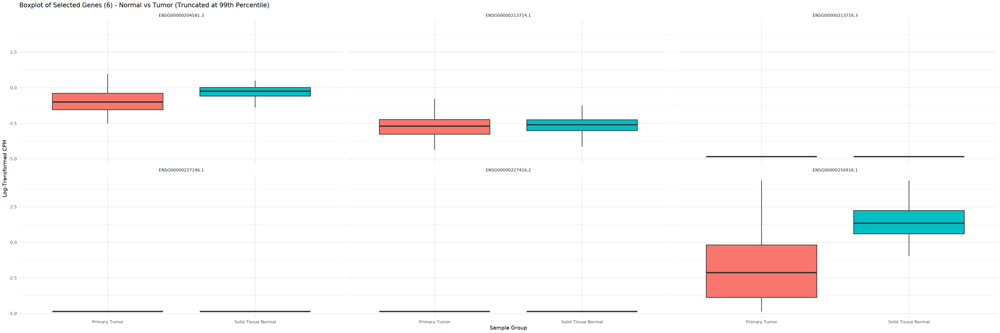

In [837]:
# Reshape for ggplot (convert to long format)
logCPM_brca_99_long <- melt(logCPM_brca_99,id.vars = "rn", variable.name = "Sample", value.name = "Expression") %>%
    mutate(sample_type= brca_batchs_paired$sample_type[Sample])
# Create a boxplot for the same selected genes divided by sample type after truncation
ggplot(logCPM_brca_99_long %>% filter(rn %in% selected_genes) , aes(x = sample_type, y = Expression, fill = sample_type)) +
  geom_boxplot(outlier.shape = NA) +  # No outliers displayed in the plot
  labs(title = "Boxplot of Selected Genes (6) - Normal vs Tumor (Truncated at 99th Percentile)",
       x = "Sample Group",
       y = "Log-Transformed CPM") +
  theme_minimal() +
  theme(legend.position = "none") +
  facet_wrap(~ rn)  # Separate plots for each gene

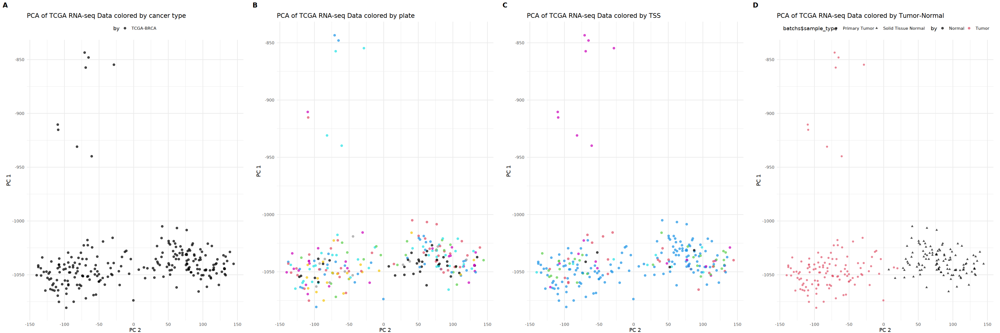

In [839]:
pca_unscaled_uncenterd_brca_normalized99 <- prcomp(t(logCPM_brca_99[,-1]), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_brca_normalized99$x), brca_batchs_paired)

The figure shows four PCA plots:
- **(A)** Colored by cancer type, all points are black because we are only analyzing BRCA cancer.
- **(B)** Colored by plate, with no clear batch effect easily detectable by eye.
- **(C)** Colored by TSS, showing no clear batch effect, but it can be observed that the 8 outlier samples all come from the same tissue site.
- **(D)** The PCA plot shows that tumor and control samples are well clustered together, indicating a clear separation between the groups. However, 8 tumor samples were detected as outliers in PC1, positioned far from the main data cluster (above -1000), suggesting potential data anomalies or batch effects that may require further investigation.

In [842]:
wiered_samples <- rownames(pca_unscaled_uncenterd_brca_normalized99$x)[which(pca_unscaled_uncenterd_brca_normalized99$x[,1] > (-1000))]
wiered_samples

[1] "TCGA-A7-A13E-01B-06R-A277-07" "TCGA-A7-A13E-01A-11R-A277-07"
[3] "TCGA-A7-A0DB-01A-11R-A277-07" "TCGA-A7-A0DB-01C-02R-A277-07"
[5] "TCGA-A7-A13G-01A-11R-A13Q-07" "TCGA-A7-A13G-01B-04R-A22O-07"
[7] "TCGA-A7-A0DC-01B-04R-A22O-07" "TCGA-A7-A0DC-01A-11R-A00Z-07"

In [744]:
# lets check their behavior in the normalized data 
logCPM_brca %>% dplyr::select(all_of(wiered_samples)) %>% head

TCGA-A7-A13E-01B-06R-A277-07,TCGA-A7-A13E-01A-11R-A277-07,TCGA-A7-A0DB-01A-11R-A277-07,TCGA-A7-A0DB-01C-02R-A277-07,TCGA-A7-A13G-01A-11R-A13Q-07,TCGA-A7-A13G-01B-04R-A22O-07,TCGA-A7-A0DC-01B-04R-A22O-07,TCGA-A7-A0DC-01A-11R-A00Z-07
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
4.699873,5.0921496,5.7039145,4.5904405,5.591442,3.93900229,3.807059,6.014709
-1.101221,-0.7961921,0.1991546,-0.2220211,-1.376363,-0.06550389,-1.853107,-1.966826
4.189540,5.4159087,4.7442972,3.2622698,4.421612,3.05446263,3.837242,5.584697
4.332984,5.1623523,5.3688905,5.0701664,6.247269,5.67310459,4.282318,4.735253
3.862453,4.3591536,4.0085753,3.9825512,4.201083,3.51975195,2.733943,3.650863
1.416184,1.7480988,4.3290317,1.2218983,1.490362,2.16044596,2.170087,0.718840


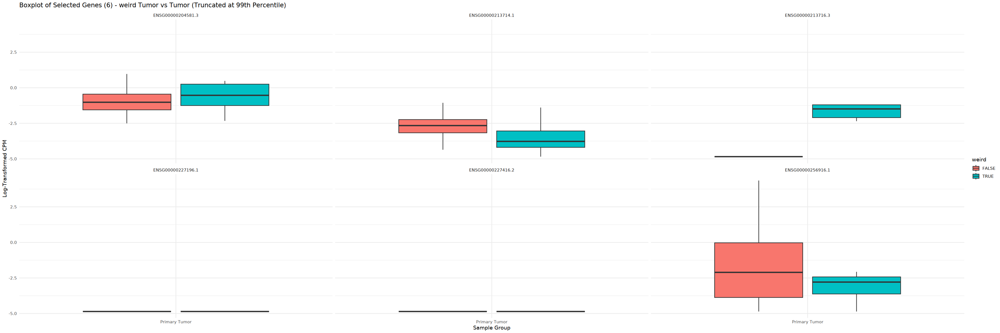

In [850]:
# Create a boxplot for the same selected genes divided by sample type after truncation
ggplot(logCPM_brca_99_long %>% filter(rn %in% selected_genes & sample_type == "Primary Tumor") %>% mutate(weird = Sample %in% wiered_samples) ,
       aes(x = sample_type, y = Expression, fill = weird)) +
  geom_boxplot(outlier.shape = NA) +  # No outliers displayed in the plot
  labs(title = "Boxplot of randomly Selected Genes (6) - weird Tumor vs Tumor (Truncated at 99th Percentile)",
       x = "Sample Group",
       y = "Log-Transformed CPM") +
  theme_minimal() +
  facet_wrap(~ rn)  # Separate plots for each gene

**⚠️ Note:**
We have noticed earlier that some samples are duplicated. Let's revisit and check if there is an intersection between the duplicated tumor samples and these weird tumor samples.

In [851]:
brca_batchs_paired %>% filter(groups =="Tumor" ) %>% 
    filter(duplicated(participant)| duplicated(participant,fromLast = T)) %>% arrange(participant) %>% .$participant %>% unique

[1] A0DB A0DC A13E A13G
113 Levels: A0AU A0AY A0AZ A0B3 A0B5 A0B7 A0B8 A0BA A0BC A0BJ A0BM A0BQ ... A2FM

In [858]:
wiered_participants <-brca_batchs_paired %>% filter(barcode %in% wiered_samples) %>% arrange(participant) %>% .$participant %>% unique
wiered_participants

[1] A0DB A0DC A13E A13G
113 Levels: A0AU A0AY A0AZ A0B3 A0B5 A0B7 A0B8 A0BA A0BC A0BJ A0BM A0BQ ... A2FM

>We can clearly see that these weird samples come from participants who provided two or more samples from the same tumor tissue sites.

In [854]:
brca_batchs_paired$tss %>% table

.
 A7  AC  BH  E2  E9  GI 
 22   8 146  22  30   4 

>The comun thing between these samples that are coming from A7 tss , according to  [TCGA](https://gdc.cancer.gov/resources-tcga-users/tcga-code-tables/tissue-source-site-codes) is Christiana Healthcare source site and from the study named "Breast invasive carcinoma", with a BCR: NCH.

**Hypothesis about these samples:** The issue may be with these specific participants, and we might need to remove their corresponding control samples as well. Could this be due to a potential batch effect? Let’s take a closer look at these participants.

In [855]:
brca_batchs_paired %>%filter(participant %in%  (brca_batchs_paired %>% filter(barcode %in% wiered_samples) %>% .$participant %>% unique)) %>%
    arrange(plate, participant,sampleVial,portionAnalyte )%>% mutate(weird = barcode %in% wiered_samples) %>% dplyr::select(participant, sampleVial,portionAnalyte,plate, groups, weird)

,participant,sampleVial,portionAnalyte,plate,groups,weird
,<fct>,<fct>,<fct>,<fct>,<fct>,<lgl>
TCGA-A7-A0DB-01A-11R-A00Z-07,A0DB,01A,11R,A00Z,Tumor,FALSE
TCGA-A7-A0DC-01A-11R-A00Z-07,A0DC,01A,11R,A00Z,Tumor,TRUE
TCGA-A7-A0DB-11A-33R-A089-07,A0DB,11A,33R,A089,Normal,FALSE
TCGA-A7-A0DC-11A-41R-A089-07,A0DC,11A,41R,A089,Normal,FALSE
TCGA-A7-A13E-01A-11R-A12P-07,A13E,01A,11R,A12P,Tumor,FALSE
TCGA-A7-A13E-11A-61R-A12P-07,A13E,11A,61R,A12P,Normal,FALSE
TCGA-A7-A13G-01A-11R-A13Q-07,A13G,01A,11R,A13Q,Tumor,TRUE
TCGA-A7-A13G-11A-51R-A13Q-07,A13G,11A,51R,A13Q,Normal,FALSE
TCGA-A7-A0DC-01B-04R-A22O-07,A0DC,01B,04R,A22O,Tumor,TRUE


#### Possible Problems with outlier samples captured by PCA

The issue likely stems from **batch effects** or **technical variability** associated with specific experimental conditions. All the "weird" samples (marked as `TRUE`) share common features, such as being processed on the same plates (A277, A22O, A13Q). This suggests that the **plate or sample processing conditions** may have introduced **systematic differences** that cause these samples to cluster separately in PCA analysis.

>- The problem is likely **technical artifacts** or **batch effects** tied to specific plates or conditions rather than biological differences.
>- Addressing this may involve **batch correction** methods (e.g., COMBAT) or removing these samples if they cannot be corrected adequately.


In [856]:
brca_batchs_paired %>% arrange(plate) %>% .$plate %>%table

.
A00Z A056 A084 A089 A115 A12D A12P A137 A13Q A144 A14D A14M A157 A169 A16F A17B 
   7   14    3   22   10   32   30   14   30   12   10    6   18    6    2    4 
A19E A19W A21T A22O A277 A466 
   1    2    2    2    4    1 

>**Plates 277, A22O  have only these wiered samples!**

In [857]:
platesPerCancers %>% filter(plate %in% c("A277","A22O"))

plate,project_id,usedInCancers
<fct>,<fct>,<int>
A277,TCGA-BLCA,6
A277,TCGA-BRCA,6
A277,TCGA-COAD,6
A277,TCGA-KIRC,6
A277,TCGA-LUAD,6
A277,TCGA-UCEC,6


>**"A22O"** plate were used only in BRCA project.

### Data re-selection
Considering that these samples are causing significant noise in our data, we have decided to remove the data from these 4 patients. This decision is based on the need to minimize the impact of these outliers and reanalyze the study. 

In [859]:
wiered_participants

[1] A0DB A0DC A13E A13G
113 Levels: A0AU A0AY A0AZ A0B3 A0B5 A0B7 A0B8 A0BA A0BC A0BJ A0BM A0BQ ... A2FM

After removing these participants, the dataset will consist of:

- Primary Tumor: 109
- Solid Tissue Normal: 109

In [860]:
brca_batchs_paired %>% filter(!participant %in% wiered_participants) %>% .$sample_type %>% table

.
      Primary Tumor Solid Tissue Normal 
                109                 109 

In [862]:
brca_batchs_paired <- brca_batchs_paired %>% filter(!participant %in% wiered_participants)
brca_batchs_paired <-droplevels(brca_batchs_paired)
brca_count_paired <- brca_count %>% dplyr::select(all_of(c("rn",brca_batchs_paired$barcode)))

In [865]:
dim(brca_count_paired[,-1])

[1] 58329   218

In [864]:
dim(brca_batchs_paired)

[1] 218  16

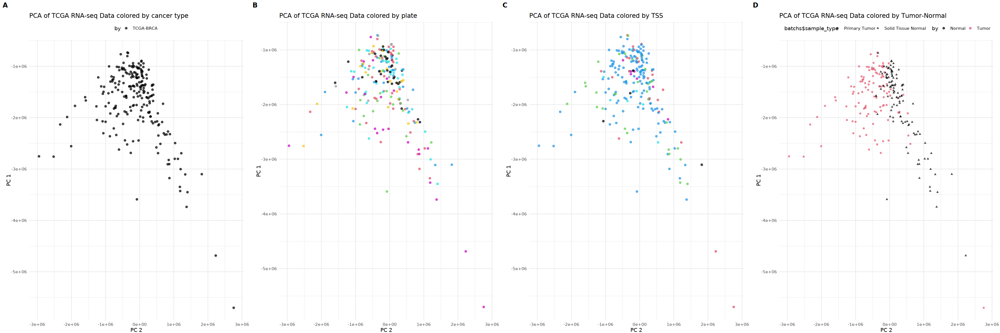

In [870]:
pca_unscaled_uncenterd_brca_count_paired <- prcomp(t(brca_count_paired[,-1]), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_brca_count_paired$x), brca_batchs_paired)

### Normalization TMM and Log-transformation

In [866]:
# Normalization
dge_brca <- do_normalization(brca_count_paired,brca_batchs_paired,method ="TMM", group_col = "sample_type") 
# Log-transformation
logCPM_brca <- cpm(dge_brca, log=TRUE)
rownames(logCPM_brca)<- dge_brca$rn
logCPM_brca <- as.data.table(logCPM_brca, keep.rownames = T)

### Trunction at the 99th percentile

In [867]:
logCPM_brca_99 <- truncate_at_percentile(logCPM_brca[, -1], truncation_percentil = 0.99)
rownames(logCPM_brca_99) <- logCPM_brca$rn
logCPM_brca_99 <- as.data.table(logCPM_brca_99, keep.rownames = T)

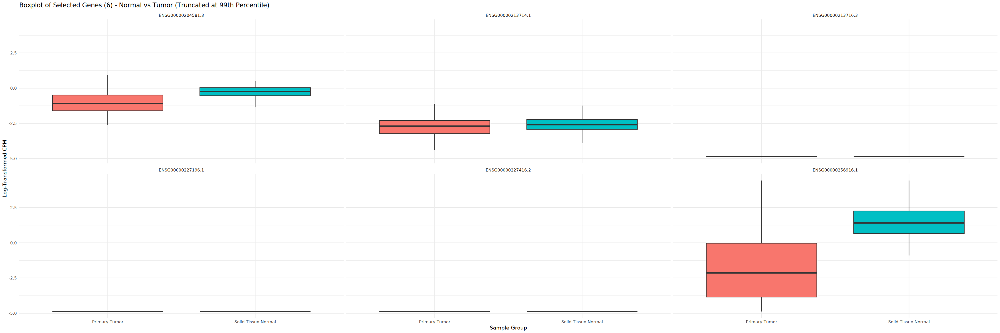

In [868]:
# Reshape for ggplot (convert to long format)
logCPM_brca_99_long <- melt(logCPM_brca_99,id.vars = "rn", variable.name = "Sample", value.name = "Expression") %>%
    mutate(sample_type= brca_batchs_paired$sample_type[Sample])
# Create a boxplot for the same selected genes divided by sample type after truncation
ggplot(logCPM_brca_99_long %>% filter(rn %in% selected_genes) , aes(x = sample_type, y = Expression, fill = sample_type)) +
  geom_boxplot(outlier.shape = NA) +  # No outliers displayed in the plot
  labs(title = "Boxplot of Selected Genes (6) - Normal vs Tumor (Truncated at 99th Percentile)",
       x = "Sample Group",
       y = "Log-Transformed CPM") +
  theme_minimal() +
  theme(legend.position = "none") +
  facet_wrap(~ rn)  # Separate plots for each gene

### Principal component analysis

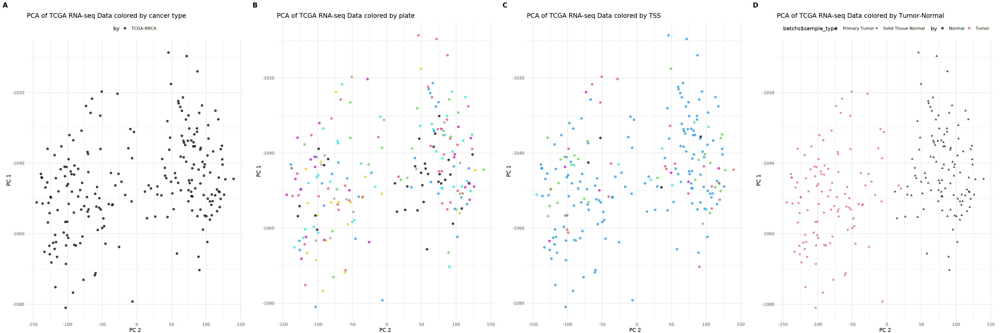

In [869]:
pca_unscaled_uncenterd_brca_normalized99 <- prcomp(t(logCPM_brca_99[,-1]), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_brca_normalized99$x), brca_batchs_paired)

In [871]:
res.pca.brca <- PCA(t(logCPM_brca_99[,-1]), graph = FALSE, ncp = 4, scale.unit = F)

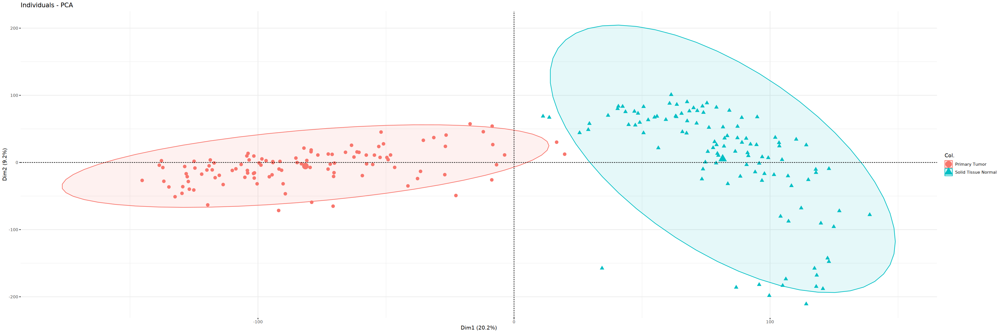

In [875]:
fviz_pca_ind(res.pca.brca, geom = "point",  pointsize = 3, addEllipses = T,
             col.ind = brca_batchs_paired$sample_type)

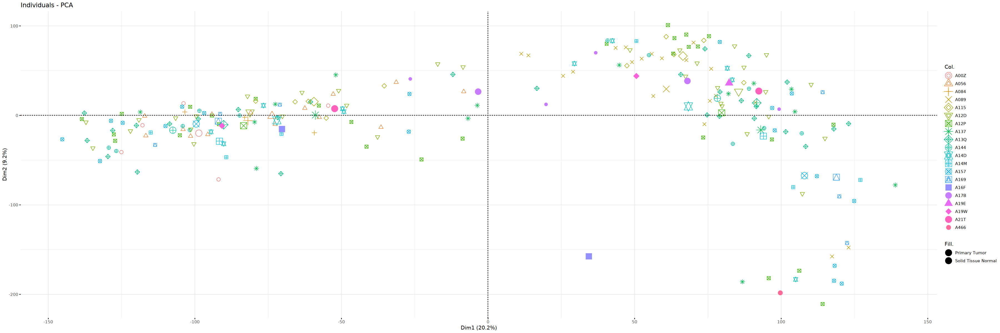

In [876]:
fviz_pca_ind(res.pca.brca, geom = "point",  pointsize = 3, addEllipses =F, ellipse.level=0.95, fill.ind = brca_batchs_paired$sample_type,
             col.ind = brca_batchs_paired$plate)

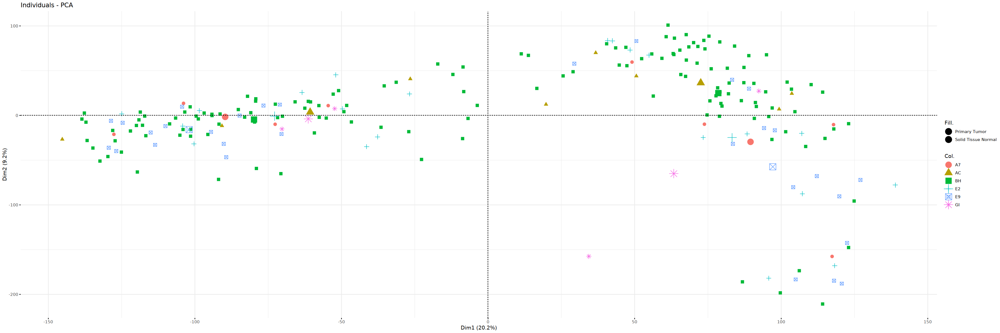

In [879]:
fviz_pca_ind(res.pca.brca, geom = "point",  pointsize = 3, addEllipses =F, ellipse.level=0.95, fill.ind = brca_batchs_paired$sample_type, 
             col.ind = brca_batchs_paired$tss)

In [ ]:
# batch effect if there is : I dont concider that they are batch effect to remove ! but let have a look if data get better 

### Batch effect removal using Combat

In [881]:
my_mod_brca <-model.matrix(~as.factor(groups), data=brca_batchs_paired)
# Apply ComBat for plate BE
brca_combat4plate <- sva::ComBat(dat = logCPM_brca_99[,-1],
                 mod = my_mod_brca,
                  batch = brca_batchs_paired$plate, 
                  par.prior = TRUE, 
                  prior.plots = FALSE)

Found 23527 genes with uniform expression within a single batch (all zeros); these will not be adjusted for batch.


Using the 'mean only' version of ComBat

Found20batches

Note: one batch has only one sample, setting mean.only=TRUE

Adjusting for1covariate(s) or covariate level(s)

Standardizing Data across genes

Fitting L/S model and finding priors

Finding parametric adjustments

Adjusting the Data




In [884]:
rownames(brca_combat4plate)<-logCPM_brca_99$rn
brca_combat4plate<-as.data.table(brca_combat4plate, keep.rownames = T)

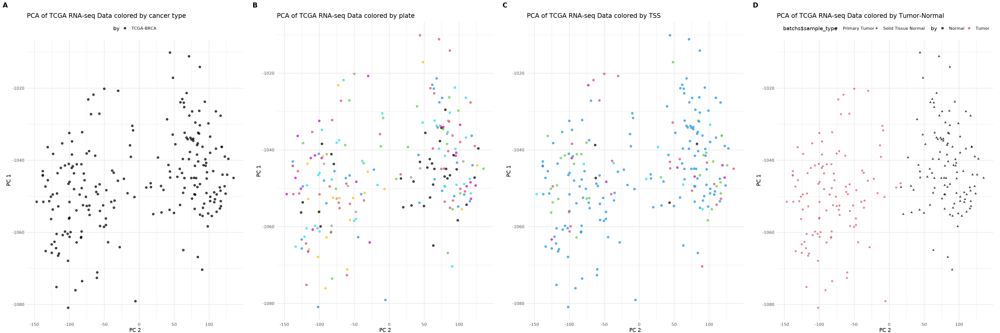

In [885]:
pca_unscaled_uncenterd_brca_combat4plate <- prcomp(t(brca_combat4plate[,-1]), scale = F, center = F)
plot_PCAs(as.data.table(pca_unscaled_uncenterd_brca_combat4plate$x), brca_batchs_paired)

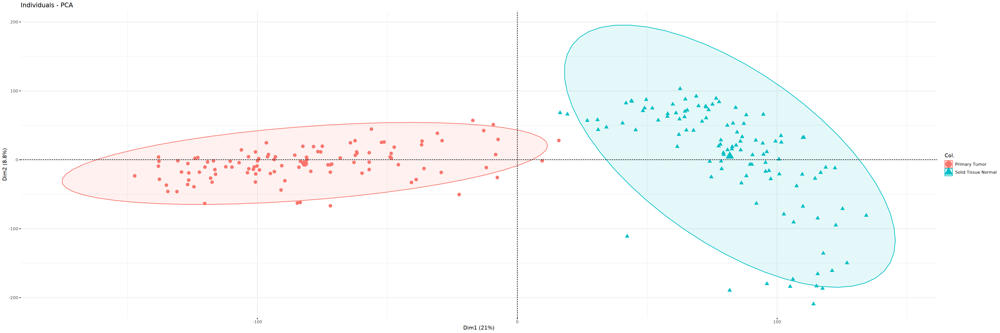

In [886]:
res.pca.brca.combat <- PCA(t(brca_combat4plate[,-1]), graph = FALSE, ncp = 4, scale.unit = F)
fviz_pca_ind(res.pca.brca.combat, geom = "point",  pointsize = 3, addEllipses = T,
             col.ind = brca_batchs_paired$sample_type)

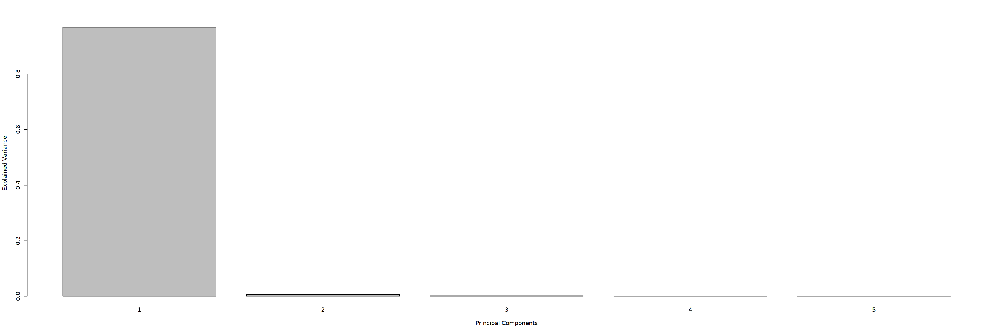

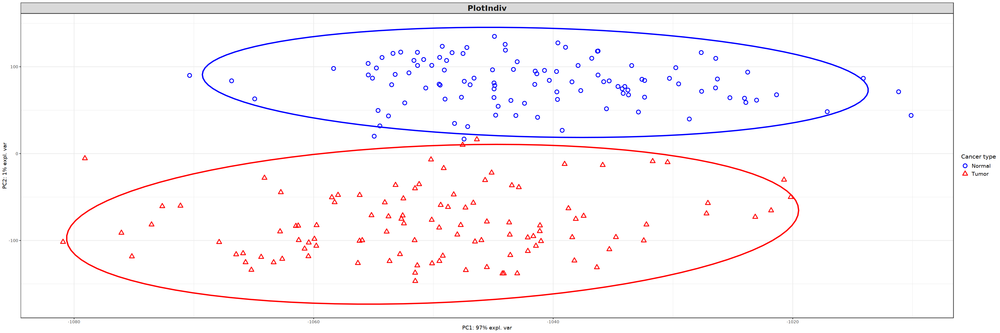

In [888]:
mypca_brca_combat = mixOmics::pca(t(brca_combat4plate[,-1]), ncomp = 5, center = FALSE, scale = FALSE)
plot(mypca_brca_combat)
plotIndiv(mypca_brca_combat, comp = 1:2, col.per.group = levels(brca_batchs_paired$c_by_group), ind.names = 
              FALSE,
          group = brca_batchs_paired$groups,
          # graphical parameters
              style = "ggplot2",
          legend = TRUE, legend.position = "right", 
          legend.title = "Cancer type", 
          legend.title.pch = 'Sample types',              
          legend.pch = FALSE,  # Show point shape in the legend
          ellipse = TRUE, 
          ellipse.level = 0.95)

>The PCA plot shows that PC1 explains 97% of the variance in the data, indicating that the first principal component captures most of the variability. This suggests that the major source of variation in our dataset is well represented by PC1, potentially reflecting a key biological or technical factor in the data.

### save data for metabopathia

In [889]:
# Final Check : if the meta data and Gene expression data has the same samples:
all(colnames(brca_combat4plate[,-1]) %in% brca_batchs_paired$barcode) # are all in ?

[1] TRUE

In [894]:
fwrite(x = brca_combat4plate, file = file.path(my_dir, paste0("BRCA_119Nx119T_paired_normalized_trun99_combat_data_", version_of_data,".tsv")),quote = F, append = F, sep = "\t", row.names = F, col.names = T, verbose = F)

In [893]:
fwrite(x = brca_batchs_paired, file = file.path(my_dir, paste0("BRCA_119Nx119T_paired_metadata_", version_of_data,".tsv")),quote = F, append = F, sep = "\t", row.names = F, col.names = T, verbose = F)

In [895]:
# The end !